# Cloud Radiative Effect

## Import packages

In [1]:
import numpy as np
import xarray as xr
import matplotlib
import matplotlib.pyplot as plt
import netCDF4
import pandas as pd
import seaborn as sns
from matplotlib.colors import LogNorm
from scipy import stats

## Create Pandas Series

In [2]:
Years = [16,17,18]
Months = list(range(1,13))

Obs_CRE = pd.Series(dtype='float64',name='Obs_CRE')
Obs_SWCRE = pd.Series(dtype='float64',name='Obs_SWCRE')
Obs_LWCRE = pd.Series(dtype='float64',name='Obs_LWCRE')
Obs_SWclr = pd.Series(dtype='float64',name='Obs_SWclr')
Obs_LWclr = pd.Series(dtype='float64',name='Obs_LWclr')
ACCESS_CRE = pd.Series(dtype='float64',name='ACCESS_CRE')
ACCESS_SWCRE = pd.Series(dtype='float64',name='ACCESS_SWCRE')
ACCESS_LWCRE = pd.Series(dtype='float64',name='ACCESS_LWCRE')
ACCESS_SWclr = pd.Series(dtype='float64',name='ACCESS_SWclr')
ACCESS_LWclr = pd.Series(dtype='float64',name='ACCESS_LWclr')
Sat_CRE = pd.Series(dtype='float64',name='Sat_CRE')
Sat_SWCRE = pd.Series(dtype='float64',name='Sat_SWCRE')
Sat_LWCRE = pd.Series(dtype='float64',name='Sat_LWCRE')
Sat_SWclr = pd.Series(dtype='float64',name='Sat_SWclr')
Sat_LWclr = pd.Series(dtype='float64',name='Sat_LWclr')

In [3]:
Years = [16,17,18]
Months = list(range(1,13))

daily_obs_CSd = pd.Series(dtype='float64',name='ClearSky_BdR')
daily_obs_CSm = pd.Series(dtype='float64',name='ClearSky_BmR')
daily_obs_Sat = pd.Series(dtype='float64',name='Saturated_Percent')
daily_obs_Sol = pd.Series(dtype='float64',name='Solar_Altitude')
ACCESS_LOW = pd.Series(dtype='float64',name='ACCESS Low Cloud Fraction')
ACCESS_MID = pd.Series(dtype='float64',name='ACCESS Medium Cloud Fraction')
ACCESS_HIGH = pd.Series(dtype='float64',name='ACCESS High Cloud Fraction')

In [4]:
Obs_SW = pd.Series(dtype='float64',name='Obs_SW')
Obs_LW = pd.Series(dtype='float64',name='Obs_LW')

## Loop for reading the data and data cleaning

In [5]:
for Year in Years:
    for Month in Months:
        if (Year == 16) and (Month < 4):
            continue
        elif (Year == 18) and (Month > 3):
            continue
        else:
            filename = '/Users/peizhangcheng/Desktop/Honours/Datasets/b*400_ACCESS_nudged/bx400_SH_met_daily_20' + str(Year) + '-' + str(Month).rjust(2,'0') + '.nc'
            data = xr.open_dataset(filename) 
            # open the model output
            
            filename1 = '/Users/peizhangcheng/Desktop/Honours/Datasets/CERES/CERES_SYN1deg-Day_Terra-Aqua-MODIS_Ed4.1_Subset_20' + str(Year) + '-' + str(Month).rjust(2,'0') + '.nc'
            sat_data = xr.open_dataset(filename1)
            # open the satellite data
            
            fdir = '/Users/peizhangcheng/Desktop/Honours/Project/MQI Radiometers/Radiation_' + str(Year) + str(Month).rjust(2,'0') + '_v4.csv'
            obs = pd.read_csv(fdir) 
            # open the observational data
            
            data1D = data.interp(lat=-54.6208, lon=158.8556, lat_v=-54.6208, lon_u=158.8556) 
            sat_data = sat_data.interp(lat=-54.6208, lon=158.8556) 
            # locate the MI in the model
            
            obs.index = pd.DatetimeIndex(obs['DateTimeUT'])
            daily_obs = obs.resample('D').mean()
            daily_obs = daily_obs.dropna()
            daily_obs.columns = ['Pyranometer_Avg','Pyrgeometer_Avg','CRE','SW_CRE','LW_CRE','SW_clr','LW_clr']
            daily_obs = daily_obs.set_index(pd.to_datetime(daily_obs.index.values) + pd.Timedelta(hours = 12))
            daily_obs['2016-04-04'] = np.nan
            daily_obs['2016-04-09'] = np.nan
            daily_obs['2016-04-10'] = np.nan
            daily_obs['2016-05-02'] = np.nan
            daily_obs['2016-05-03'] = np.nan
            daily_obs['2016-12-15'] = np.nan
            daily_obs['2016-12-16'] = np.nan
            daily_obs['2017-04-10'] = np.nan
            daily_obs['2017-06-09'] = np.nan
            daily_obs['2018-03-06'] = np.nan
            # do some cleaning and calculate the mean
            
            if (Year == 16) and (Month == 4):
                data1D_rsds = data1D.rsds.where((data1D.rsds.time!=data1D.rsds.time[0])&(data1D.rsds.time!=data1D.rsds.time[1])&(data1D.rsds.time!=data1D.rsds.time[2]), drop=True)
                data1D_rlds = data1D.rlds.where((data1D.rlds.time!=data1D.rlds.time[0])&(data1D.rlds.time!=data1D.rlds.time[1])&(data1D.rlds.time!=data1D.rlds.time[2]), drop=True)
                data1D_rsdscs = data1D.rsdscs.where((data1D.rsdscs.time!=data1D.rsdscs.time[0])&(data1D.rsdscs.time!=data1D.rsdscs.time[1])&(data1D.rsdscs.time!=data1D.rsdscs.time[2]), drop=True)
                data1D_rldscs = data1D.rldscs.where((data1D.rldscs.time!=data1D.rldscs.time[0])&(data1D.rldscs.time!=data1D.rldscs.time[1])&(data1D.rldscs.time!=data1D.rldscs.time[2]), drop=True)
                sat_rsds = sat_data.ini_sfc_sw_down_all_daily.where((sat_data.ini_sfc_sw_down_all_daily.time!=sat_data.ini_sfc_sw_down_all_daily.time[0])&(sat_data.ini_sfc_sw_down_all_daily.time!=sat_data.ini_sfc_sw_down_all_daily.time[1])&(sat_data.ini_sfc_sw_down_all_daily.time!=sat_data.ini_sfc_sw_down_all_daily.time[2]), drop=True)
                sat_rlds = sat_data.ini_sfc_lw_down_all_daily.where((sat_data.ini_sfc_lw_down_all_daily.time!=sat_data.ini_sfc_lw_down_all_daily.time[0])&(sat_data.ini_sfc_lw_down_all_daily.time!=sat_data.ini_sfc_lw_down_all_daily.time[1])&(sat_data.ini_sfc_lw_down_all_daily.time!=sat_data.ini_sfc_lw_down_all_daily.time[2]), drop=True)                
                sat_rsdscs = sat_data.ini_sfc_sw_down_clr_daily.where((sat_data.ini_sfc_sw_down_clr_daily.time!=sat_data.ini_sfc_sw_down_clr_daily.time[0])&(sat_data.ini_sfc_sw_down_clr_daily.time!=sat_data.ini_sfc_sw_down_clr_daily.time[1])&(sat_data.ini_sfc_sw_down_clr_daily.time!=sat_data.ini_sfc_sw_down_clr_daily.time[2]), drop=True)
                sat_rldscs = sat_data.ini_sfc_lw_down_clr_daily.where((sat_data.ini_sfc_lw_down_clr_daily.time!=sat_data.ini_sfc_lw_down_clr_daily.time[0])&(sat_data.ini_sfc_lw_down_clr_daily.time!=sat_data.ini_sfc_lw_down_clr_daily.time[1])&(sat_data.ini_sfc_lw_down_clr_daily.time!=sat_data.ini_sfc_lw_down_clr_daily.time[2]), drop=True)                
                pd_data1D_rsds = pd.Series(data1D_rsds.to_pandas(),name='ACCESS_rsds')
                pd_data1D_rlds = pd.Series(data1D_rlds.to_pandas(),name='ACCESS_rlds')
                pd_data1D_rsdscs = pd.Series(data1D_rsdscs.to_pandas(),name='ACCESS_rsdscs')
                pd_data1D_rldscs = pd.Series(data1D_rldscs.to_pandas(),name='ACCESS_rldscs')
                pd_sat_rsds = pd.Series(sat_rsds.to_pandas(),name='Sat_rsds')
                pd_sat_rlds = pd.Series(sat_rlds.to_pandas(),name='Sat_rlds')
                pd_sat_rsdscs = pd.Series(sat_rsdscs.to_pandas(),name='Sat_rsdscs')
                pd_sat_rldscs = pd.Series(sat_rldscs.to_pandas(),name='Sat_rldscs')
                # make the number of data in obs and model consistent
            elif (Year == 18) and (Month == 3):
                pd_data1D_rsds = pd.Series(data1D.rsds.to_pandas(),name='ACCESS_rsds')
                pd_data1D_rsds = pd_data1D_rsds[:6]
                pd_data1D_rlds = pd.Series(data1D.rlds.to_pandas(),name='ACCESS_rlds')
                pd_data1D_rlds = pd_data1D_rlds[:6]
                pd_data1D_rsdscs = pd.Series(data1D.rsdscs.to_pandas(),name='ACCESS_rsdscs')
                pd_data1D_rsdscs = pd_data1D_rsdscs[:6]
                pd_data1D_rldscs = pd.Series(data1D.rldscs.to_pandas(),name='ACCESS_rldscs')
                pd_data1D_rldscs = pd_data1D_rldscs[:6]
                pd_sat_rsds = pd.Series(sat_data.ini_sfc_sw_down_all_daily.to_pandas(),name='Sat_rsds')
                pd_sat_rsds = pd_sat_rsds[:6]
                pd_sat_rlds = pd.Series(sat_data.ini_sfc_lw_down_all_daily.to_pandas(),name='Sat_rlds')
                pd_sat_rlds = pd_sat_rlds[:6]
                pd_sat_rsdscs = pd.Series(sat_data.ini_sfc_sw_down_clr_daily.to_pandas(),name='Sat_rsdscs')
                pd_sat_rsdscs = pd_sat_rsdscs[:6]
                pd_sat_rldscs = pd.Series(sat_data.ini_sfc_lw_down_clr_daily.to_pandas(),name='Sat_rldscs')
                pd_sat_rldscs = pd_sat_rldscs[:6]
            else:
                pd_data1D_rsds = pd.Series(data1D.rsds.to_pandas(),name='ACCESS_rsds')
                pd_data1D_rlds = pd.Series(data1D.rlds.to_pandas(),name='ACCESS_rlds')
                pd_data1D_rsdscs = pd.Series(data1D.rsdscs.to_pandas(),name='ACCESS_rsdscs')
                pd_data1D_rldscs = pd.Series(data1D.rldscs.to_pandas(),name='ACCESS_rldscs')
                pd_sat_rsds = pd.Series(sat_data.ini_sfc_sw_down_all_daily.to_pandas(),name='Sat_rsds')
                pd_sat_rlds = pd.Series(sat_data.ini_sfc_lw_down_all_daily.to_pandas(),name='Sat_rlds')
                pd_sat_rsdscs = pd.Series(sat_data.ini_sfc_sw_down_clr_daily.to_pandas(),name='Sat_rsdscs')
                pd_sat_rldscs = pd.Series(sat_data.ini_sfc_lw_down_clr_daily.to_pandas(),name='Sat_rldscs')
                # convert the model data into pandas Series to plot
            
            ACCESS_CRE1 = (1-0.055)*(pd_data1D_rsds-pd_data1D_rsdscs)+0.97*(pd_data1D_rlds-pd_data1D_rldscs)
            ACCESS_SWCRE1 = (1-0.055)*(pd_data1D_rsds-pd_data1D_rsdscs)
            ACCESS_LWCRE1 = 0.97*(pd_data1D_rlds-pd_data1D_rldscs)
            Sat_CRE1 = (1-0.055)*(pd_sat_rsds-pd_sat_rsdscs)+0.97*(pd_sat_rlds-pd_sat_rldscs)
            Sat_SWCRE1 = (1-0.055)*(pd_sat_rsds-pd_sat_rsdscs)
            Sat_LWCRE1 = 0.97*(pd_sat_rlds-pd_sat_rldscs)
            
            ACCESS_CRE = pd.concat([ACCESS_CRE, ACCESS_CRE1], axis=0)
            ACCESS_SWCRE = pd.concat([ACCESS_SWCRE, ACCESS_SWCRE1], axis=0)
            ACCESS_LWCRE = pd.concat([ACCESS_LWCRE, ACCESS_LWCRE1], axis=0)
            ACCESS_SWclr = pd.concat([ACCESS_SWclr, pd_data1D_rsdscs], axis=0)
            ACCESS_LWclr = pd.concat([ACCESS_LWclr, pd_data1D_rldscs], axis=0)
            Sat_CRE = pd.concat([Sat_CRE, Sat_CRE1], axis=0)
            Sat_SWCRE = pd.concat([Sat_SWCRE, Sat_SWCRE1], axis=0)
            Sat_LWCRE = pd.concat([Sat_LWCRE, Sat_LWCRE1], axis=0)
            Sat_SWclr = pd.concat([Sat_SWclr, pd_sat_rsdscs], axis=0)
            Sat_LWclr = pd.concat([Sat_LWclr, pd_sat_rldscs], axis=0)
            Obs_CRE = pd.concat([Obs_CRE, daily_obs.CRE], axis=0)
            Obs_SWCRE = pd.concat([Obs_SWCRE, daily_obs.SW_CRE], axis=0)
            Obs_LWCRE = pd.concat([Obs_LWCRE, daily_obs.LW_CRE], axis=0)
            Obs_SWclr = pd.concat([Obs_SWclr, daily_obs.SW_clr], axis=0)
            Obs_LWclr = pd.concat([Obs_LWclr, daily_obs.LW_clr], axis=0)
                # concat the observational data and model output

<ipython-input-5-50ba334ed00e>:29: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  daily_obs['2016-04-04'] = np.nan
<ipython-input-5-50ba334ed00e>:30: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  daily_obs['2016-04-09'] = np.nan
<ipython-input-5-50ba334ed00e>:31: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  daily_obs['2016-04-10'] = np.nan
<ipython-input-5-50ba334ed00e>:32: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[s

In [16]:
for Year in Years:
    for Month in Months:
        if (Year == 16) and (Month < 4):
            continue
        elif (Year == 18) and (Month > 3):
            continue
        else:
            filename = '/Users/peizhangcheng/Desktop/Datasets/b*400_ACCESS_nudged/bx400_SH_met_daily_20' + str(Year) + '-' + str(Month).rjust(2,'0') + '.nc'
            data = xr.open_dataset(filename) 
            # open the model output
            
            fdir = '/Users/peizhangcheng/Desktop/UTAS/Honours/Project/MQI Radiometers/Cloud_' + str(Year) + str(Month).rjust(2,'0') + '.csv'
            obs = pd.read_csv(fdir) 
            # open the observational data
            
            data1D = data.interp(lat=-54.6208, lon=158.8556, lat_v=-54.6208, lon_u=158.8556)
            # locate the MI in the model
            
            obs.index = pd.DatetimeIndex(obs['DateTimeUT'])
            daily_obs = obs.resample('D').mean()
            daily_obs = daily_obs.dropna()
            daily_obs.columns = ['ClearSky_BdR','ClearSky_BmR','Saturated_Percent','Solar_Altitude']
            daily_obs = daily_obs.set_index(pd.to_datetime(daily_obs.index.values) + pd.Timedelta(hours = 12))
            # do some cleaning and calculate the mean
            
            if (Year == 16) and (Month == 4):
                pd_ACCESS_LOW1 = data1D.field9203.where((data1D.field9203.time!=data1D.field9203.time[0])&(data1D.field9203.time!=data1D.field9203.time[1])&(data1D.field9203.time!=data1D.field9203.time[2]), drop=True)
                pd_ACCESS_MID1 = data1D.field9204.where((data1D.field9204.time!=data1D.field9204.time[0])&(data1D.field9204.time!=data1D.field9204.time[1])&(data1D.field9204.time!=data1D.field9204.time[2]), drop=True)
                pd_ACCESS_HIGH1 = data1D.field9205.where((data1D.field9204.time!=data1D.field9204.time[0])&(data1D.field9204.time!=data1D.field9204.time[1])&(data1D.field9204.time!=data1D.field9204.time[2]), drop=True)
                pd_ACCESS_LOW = pd.Series(pd_ACCESS_LOW1.to_pandas(),name='ACCESS Low Cloud Fraction')
                pd_ACCESS_MID = pd.Series(pd_ACCESS_MID1.to_pandas(),name='ACCESS Medium Cloud Fraction')
                pd_ACCESS_HIGH = pd.Series(pd_ACCESS_HIGH1.to_pandas(),name='ACCESS High Cloud Fraction')
            elif (Year == 18) and (Month == 3):
                pd_ACCESS_LOW = pd.Series(data1D.field9203.to_pandas(),name='ACCESS Low Cloud Fraction')
                pd_ACCESS_LOW = pd_ACCESS_LOW[:6]
                pd_ACCESS_MID = pd.Series(data1D.field9204.to_pandas(),name='ACCESS Medium Cloud Fraction')
                pd_ACCESS_MID = pd_ACCESS_MID[:6]
                pd_ACCESS_HIGH = pd.Series(data1D.field9205.to_pandas(),name='ACCESS High Cloud Fraction')
                pd_ACCESS_HIGH = pd_ACCESS_HIGH[:6]
            else:    
                pd_ACCESS_LOW = pd.Series(data1D.field9203.to_pandas(),name='ACCESS Low Cloud Fraction')
                pd_ACCESS_MID = pd.Series(data1D.field9204.to_pandas(),name='ACCESS Medium Cloud Fraction')
                pd_ACCESS_HIGH = pd.Series(data1D.field9205.to_pandas(),name='ACCESS High Cloud Fraction')
            
            daily_obs_CSd = pd.concat([daily_obs_CSd, daily_obs.ClearSky_BdR], axis=0)
            daily_obs_CSm = pd.concat([daily_obs_CSm, daily_obs.ClearSky_BmR], axis=0)
            daily_obs_Sat = pd.concat([daily_obs_Sat, daily_obs.Saturated_Percent], axis=0)
            daily_obs_Sol = pd.concat([daily_obs_Sol,daily_obs.Solar_Altitude], axis=0)
            ACCESS_LOW = pd.concat([ACCESS_LOW, pd_ACCESS_LOW], axis=0)
            ACCESS_MID = pd.concat([ACCESS_MID, pd_ACCESS_MID], axis=0)
            ACCESS_HIGH = pd.concat([ACCESS_HIGH, pd_ACCESS_HIGH], axis=0)
                # concat the observational data and model output

In [18]:
for Year in Years:
    for Month in Months:
        if (Year == 16) and (Month < 4):
            continue
        elif (Year == 18) and (Month > 3):
            continue
        else:
            filename = '/Users/peizhangcheng/Desktop/Datasets/b*400_ACCESS_nudged/bx400_SH_met_daily_20' + str(Year) + '-' + str(Month).rjust(2,'0') + '.nc'
            data = xr.open_dataset(filename) 
            # open the model output
            
            filename1 = '/Users/peizhangcheng/Desktop/Datasets/CERES/CERES_SYN1deg-Day_Terra-Aqua-MODIS_Ed4.1_Subset_20' + str(Year) + '-' + str(Month).rjust(2,'0') + '.nc'
            sat_data = xr.open_dataset(filename1)
            # open the satellite data
            
            fdir = '/Users/peizhangcheng/Desktop/UTAS/Honours/Project/MQI Radiometers/Radiation_' + str(Year) + str(Month).rjust(2,'0') + '.csv'
            daily_obs = pd.read_csv(fdir) 
            # open the observational data
            
            data1D = data.interp(lat=-54.6208, lon=158.8556, lat_v=-54.6208, lon_u=158.8556) 
            sat_data = sat_data.interp(lat=-54.6208, lon=158.8556) 
            # locate the MI in the model
            
            daily_obs.index = pd.DatetimeIndex(daily_obs['DateTimeUT'])
            daily_obs = daily_obs.dropna()
            daily_obs.columns = ['DateTimeUT','Pyranometer_Avg','Pyrgeometer_Avg','CRE','SW_CRE','LW_CRE','SW_clr','LW_clr']
            daily_obs = daily_obs.set_index(pd.to_datetime(daily_obs.index.values) + pd.Timedelta(hours = 12))
            daily_obs['2016-04-04'] = np.nan
            daily_obs['2016-04-09'] = np.nan
            daily_obs['2016-04-10'] = np.nan
            daily_obs['2016-05-02'] = np.nan
            daily_obs['2016-05-03'] = np.nan
            daily_obs['2016-12-15'] = np.nan
            daily_obs['2016-12-16'] = np.nan
            daily_obs['2017-04-10'] = np.nan
            daily_obs['2017-06-09'] = np.nan
            daily_obs['2018-03-06'] = np.nan
            # do some cleaning and calculate the mean
            
            if (Year == 16) and (Month == 4):
                data1D_rsds = data1D.rsds.where((data1D.rsds.time!=data1D.rsds.time[0])&(data1D.rsds.time!=data1D.rsds.time[1])&(data1D.rsds.time!=data1D.rsds.time[2]), drop=True)
                data1D_rlds = data1D.rlds.where((data1D.rlds.time!=data1D.rlds.time[0])&(data1D.rlds.time!=data1D.rlds.time[1])&(data1D.rlds.time!=data1D.rlds.time[2]), drop=True)
                data1D_rsdscs = data1D.rsdscs.where((data1D.rsdscs.time!=data1D.rsdscs.time[0])&(data1D.rsdscs.time!=data1D.rsdscs.time[1])&(data1D.rsdscs.time!=data1D.rsdscs.time[2]), drop=True)
                data1D_rldscs = data1D.rldscs.where((data1D.rldscs.time!=data1D.rldscs.time[0])&(data1D.rldscs.time!=data1D.rldscs.time[1])&(data1D.rldscs.time!=data1D.rldscs.time[2]), drop=True)
                sat_rsds = sat_data.ini_sfc_sw_down_all_daily.where((sat_data.ini_sfc_sw_down_all_daily.time!=sat_data.ini_sfc_sw_down_all_daily.time[0])&(sat_data.ini_sfc_sw_down_all_daily.time!=sat_data.ini_sfc_sw_down_all_daily.time[1])&(sat_data.ini_sfc_sw_down_all_daily.time!=sat_data.ini_sfc_sw_down_all_daily.time[2]), drop=True)
                sat_rlds = sat_data.ini_sfc_lw_down_all_daily.where((sat_data.ini_sfc_lw_down_all_daily.time!=sat_data.ini_sfc_lw_down_all_daily.time[0])&(sat_data.ini_sfc_lw_down_all_daily.time!=sat_data.ini_sfc_lw_down_all_daily.time[1])&(sat_data.ini_sfc_lw_down_all_daily.time!=sat_data.ini_sfc_lw_down_all_daily.time[2]), drop=True)                
                sat_rsdscs = sat_data.ini_sfc_sw_down_clr_daily.where((sat_data.ini_sfc_sw_down_clr_daily.time!=sat_data.ini_sfc_sw_down_clr_daily.time[0])&(sat_data.ini_sfc_sw_down_clr_daily.time!=sat_data.ini_sfc_sw_down_clr_daily.time[1])&(sat_data.ini_sfc_sw_down_clr_daily.time!=sat_data.ini_sfc_sw_down_clr_daily.time[2]), drop=True)
                sat_rldscs = sat_data.ini_sfc_lw_down_clr_daily.where((sat_data.ini_sfc_lw_down_clr_daily.time!=sat_data.ini_sfc_lw_down_clr_daily.time[0])&(sat_data.ini_sfc_lw_down_clr_daily.time!=sat_data.ini_sfc_lw_down_clr_daily.time[1])&(sat_data.ini_sfc_lw_down_clr_daily.time!=sat_data.ini_sfc_lw_down_clr_daily.time[2]), drop=True)                
                pd_data1D_rsds = pd.Series(data1D_rsds.to_pandas(),name='ACCESS_rsds')
                pd_data1D_rlds = pd.Series(data1D_rlds.to_pandas(),name='ACCESS_rlds')
                pd_data1D_rsdscs = pd.Series(data1D_rsdscs.to_pandas(),name='ACCESS_rsdscs')
                pd_data1D_rldscs = pd.Series(data1D_rldscs.to_pandas(),name='ACCESS_rldscs')
                pd_sat_rsds = pd.Series(sat_rsds.to_pandas(),name='Sat_rsds')
                pd_sat_rlds = pd.Series(sat_rlds.to_pandas(),name='Sat_rlds')
                pd_sat_rsdscs = pd.Series(sat_rsdscs.to_pandas(),name='Sat_rsdscs')
                pd_sat_rldscs = pd.Series(sat_rldscs.to_pandas(),name='Sat_rldscs')
                # make the number of data in obs and model consistent
            elif (Year == 18) and (Month == 3):
                pd_data1D_rsds = pd.Series(data1D.rsds.to_pandas(),name='ACCESS_rsds')
                pd_data1D_rsds = pd_data1D_rsds[:6]
                pd_data1D_rlds = pd.Series(data1D.rlds.to_pandas(),name='ACCESS_rlds')
                pd_data1D_rlds = pd_data1D_rlds[:6]
                pd_data1D_rsdscs = pd.Series(data1D.rsdscs.to_pandas(),name='ACCESS_rsdscs')
                pd_data1D_rsdscs = pd_data1D_rsdscs[:6]
                pd_data1D_rldscs = pd.Series(data1D.rldscs.to_pandas(),name='ACCESS_rldscs')
                pd_data1D_rldscs = pd_data1D_rldscs[:6]
                pd_sat_rsds = pd.Series(sat_data.ini_sfc_sw_down_all_daily.to_pandas(),name='Sat_rsds')
                pd_sat_rsds = pd_sat_rsds[:6]
                pd_sat_rlds = pd.Series(sat_data.ini_sfc_lw_down_all_daily.to_pandas(),name='Sat_rlds')
                pd_sat_rlds = pd_sat_rlds[:6]
                pd_sat_rsdscs = pd.Series(sat_data.ini_sfc_sw_down_clr_daily.to_pandas(),name='Sat_rsdscs')
                pd_sat_rsdscs = pd_sat_rsdscs[:6]
                pd_sat_rldscs = pd.Series(sat_data.ini_sfc_lw_down_clr_daily.to_pandas(),name='Sat_rldscs')
                pd_sat_rldscs = pd_sat_rldscs[:6]
            else:
                pd_data1D_rsds = pd.Series(data1D.rsds.to_pandas(),name='ACCESS_rsds')
                pd_data1D_rlds = pd.Series(data1D.rlds.to_pandas(),name='ACCESS_rlds')
                pd_data1D_rsdscs = pd.Series(data1D.rsdscs.to_pandas(),name='ACCESS_rsdscs')
                pd_data1D_rldscs = pd.Series(data1D.rldscs.to_pandas(),name='ACCESS_rldscs')
                pd_sat_rsds = pd.Series(sat_data.ini_sfc_sw_down_all_daily.to_pandas(),name='Sat_rsds')
                pd_sat_rlds = pd.Series(sat_data.ini_sfc_lw_down_all_daily.to_pandas(),name='Sat_rlds')
                pd_sat_rsdscs = pd.Series(sat_data.ini_sfc_sw_down_clr_daily.to_pandas(),name='Sat_rsdscs')
                pd_sat_rldscs = pd.Series(sat_data.ini_sfc_lw_down_clr_daily.to_pandas(),name='Sat_rldscs')
                # convert the model data into pandas Series to plot
            
            ACCESS_CRE1 = (1-0.055)*(pd_data1D_rsds-pd_data1D_rsdscs)+0.97*(pd_data1D_rlds-pd_data1D_rldscs)
            ACCESS_SWCRE1 = (1-0.055)*(pd_data1D_rsds-pd_data1D_rsdscs)
            ACCESS_LWCRE1 = 0.97*(pd_data1D_rlds-pd_data1D_rldscs)
            Sat_CRE1 = (1-0.055)*(pd_sat_rsds-pd_sat_rsdscs)+0.97*(pd_sat_rlds-pd_sat_rldscs)
            Sat_SWCRE1 = (1-0.055)*(pd_sat_rsds-pd_sat_rsdscs)
            Sat_LWCRE1 = 0.97*(pd_sat_rlds-pd_sat_rldscs)
            
            ACCESS_CRE = pd.concat([ACCESS_CRE, ACCESS_CRE1], axis=0)
            ACCESS_SWCRE = pd.concat([ACCESS_SWCRE, ACCESS_SWCRE1], axis=0)
            ACCESS_LWCRE = pd.concat([ACCESS_LWCRE, ACCESS_LWCRE1], axis=0)
            ACCESS_SWclr = pd.concat([ACCESS_SWclr, pd_data1D_rsdscs], axis=0)
            ACCESS_LWclr = pd.concat([ACCESS_LWclr, pd_data1D_rldscs], axis=0)
            Sat_CRE = pd.concat([Sat_CRE, Sat_CRE1], axis=0)
            Sat_SWCRE = pd.concat([Sat_SWCRE, Sat_SWCRE1], axis=0)
            Sat_LWCRE = pd.concat([Sat_LWCRE, Sat_LWCRE1], axis=0)
            Sat_SWclr = pd.concat([Sat_SWclr, pd_sat_rsdscs], axis=0)
            Sat_LWclr = pd.concat([Sat_LWclr, pd_sat_rldscs], axis=0)
            Obs_SW = pd.concat([Obs_SW, daily_obs.Pyranometer_Avg], axis=0)
            Obs_LW = pd.concat([Obs_LW, daily_obs.Pyrgeometer_Avg], axis=0)
            Obs_CRE = pd.concat([Obs_CRE, daily_obs.CRE], axis=0)
            Obs_SWCRE = pd.concat([Obs_SWCRE, daily_obs.SW_CRE], axis=0)
            Obs_LWCRE = pd.concat([Obs_LWCRE, daily_obs.LW_CRE], axis=0)
            Obs_SWclr = pd.concat([Obs_SWclr, daily_obs.SW_clr], axis=0)
            Obs_LWclr = pd.concat([Obs_LWclr, daily_obs.LW_clr], axis=0)
                # concat the observational data and model output

<ipython-input-18-beeba3d51a7d>:29: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  daily_obs['2016-04-09'] = np.nan
<ipython-input-18-beeba3d51a7d>:30: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  daily_obs['2016-04-10'] = np.nan
<ipython-input-18-beeba3d51a7d>:31: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  daily_obs['2016-05-02'] = np.nan
<ipython-input-18-beeba3d51a7d>:32: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `fra

In [19]:
for Year in Years:
    for Month in Months:
        if (Year == 16) and (Month < 4):
            continue
        elif (Year == 18) and (Month > 3):
            continue
        else:
            filename = '/Users/peizhangcheng/Desktop/Datasets/b*400_ACCESS_nudged/bx400_SH_met_daily_20' + str(Year) + '-' + str(Month).rjust(2,'0') + '.nc'
            data = xr.open_dataset(filename) 
            # open the model output
            
            fdir = '/Users/peizhangcheng/Desktop/UTAS/Honours/Project/MQI Radiometers/Cloud_' + str(Year) + str(Month).rjust(2,'0') + '.csv'
            obs = pd.read_csv(fdir) 
            # open the observational data
            
            data1D = data.interp(lat=-54.6208, lon=158.8556, lat_v=-54.6208, lon_u=158.8556)
            # locate the MI in the model
            
            obs.index = pd.DatetimeIndex(obs['DateTimeUT'])
            #daily_obs = obs.resample('D').mean()
            #daily_obs.columns = ['ClearSky_BdR','ClearSky_BmR','Saturated_Percent','Solar_Altitude']
            obs.columns = ['DateTimeUT','ClearSky_BdR','ClearSky_BmR','Saturated_Percent','Solar_Altitude']
            obs = obs.dropna()
            #daily_obs = daily_obs.set_index(pd.to_datetime(daily_obs.index.values) + pd.Timedelta(hours = 12))
            # do some cleaning and calculate the mean
            
            if (Year == 16) and (Month == 4):
                pd_ACCESS_LOW1 = data1D.field9203.where((data1D.field9203.time!=data1D.field9203.time[0])&(data1D.field9203.time!=data1D.field9203.time[1])&(data1D.field9203.time!=data1D.field9203.time[2]), drop=True)
                pd_ACCESS_MID1 = data1D.field9204.where((data1D.field9204.time!=data1D.field9204.time[0])&(data1D.field9204.time!=data1D.field9204.time[1])&(data1D.field9204.time!=data1D.field9204.time[2]), drop=True)
                pd_ACCESS_HIGH1 = data1D.field9205.where((data1D.field9205.time!=data1D.field9205.time[0])&(data1D.field9205.time!=data1D.field9205.time[1])&(data1D.field9205.time!=data1D.field9205.time[2]), drop=True)
                pd_ACCESS_LOW = pd.Series(pd_ACCESS_LOW1.to_pandas(),name='ACCESS Low Cloud Fraction')
                pd_ACCESS_MID = pd.Series(pd_ACCESS_MID1.to_pandas(),name='ACCESS Medium Cloud Fraction')
                pd_ACCESS_HIGH = pd.Series(pd_ACCESS_HIGH1.to_pandas(),name='ACCESS High Cloud Fraction')
            elif (Year == 18) and (Month == 3):
                pd_ACCESS_LOW = pd.Series(data1D.field9203.to_pandas(),name='ACCESS Low Cloud Fraction')
                pd_ACCESS_LOW = pd_ACCESS_LOW[:6]
                pd_ACCESS_MID = pd.Series(data1D.field9204.to_pandas(),name='ACCESS Medium Cloud Fraction')
                pd_ACCESS_MID = pd_ACCESS_MID[:6]
                pd_ACCESS_HIGH = pd.Series(data1D.field9205.to_pandas(),name='ACCESS High Cloud Fraction')
                pd_ACCESS_HIGH = pd_ACCESS_HIGH[:6]
            else:    
                pd_ACCESS_LOW = pd.Series(data1D.field9203.to_pandas(),name='ACCESS Low Cloud Fraction')
                pd_ACCESS_MID = pd.Series(data1D.field9204.to_pandas(),name='ACCESS Medium Cloud Fraction')
                pd_ACCESS_HIGH = pd.Series(data1D.field9205.to_pandas(),name='ACCESS High Cloud Fraction')
            
            daily_obs_CSd = pd.concat([daily_obs_CSd, obs.ClearSky_BdR], axis=0)
            daily_obs_CSm = pd.concat([daily_obs_CSm, obs.ClearSky_BmR], axis=0)
            daily_obs_Sat = pd.concat([daily_obs_Sat, obs.Saturated_Percent], axis=0)
            daily_obs_Sol = pd.concat([daily_obs_Sol, obs.Solar_Altitude], axis=0)
            
            #daily_obs_CSd = pd.concat([daily_obs_CSd, daily_obs.ClearSky_BdR], axis=0)
            #daily_obs_CSm = pd.concat([daily_obs_CSm, daily_obs.ClearSky_BmR], axis=0)
            #daily_obs_Sat = pd.concat([daily_obs_Sat, daily_obs.Saturated_Percent], axis=0)
            #daily_obs_Sol = pd.concat([daily_obs_Sol,daily_obs.Solar_Altitude], axis=0)
            #ACCESS_LOW = pd.concat([ACCESS_LOW, pd_ACCESS_LOW], axis=0)
            #ACCESS_MID = pd.concat([ACCESS_MID, pd_ACCESS_MID], axis=0)
            #ACCESS_HIGH = pd.concat([ACCESS_HIGH, pd_ACCESS_HIGH], axis=0)
                # concat the observational data and model output

In [20]:
print(np.percentile(daily_obs_CSd,99))
print(np.percentile(daily_obs_CSm,99))

0.713325883527608
0.776581293828078


In [21]:
daily_obs_cs = []

In [22]:
for i in np.arange(len(daily_obs_CSd)):
    if daily_obs_CSd[i] > 0.7:
        daily_obs_cs.append(daily_obs_CSd.index[i])

In [23]:
daily_obs_cs

[Timestamp('2016-04-07 22:56:00'),
 Timestamp('2016-04-07 22:57:00'),
 Timestamp('2016-04-07 22:58:00'),
 Timestamp('2016-04-07 23:00:00'),
 Timestamp('2016-04-16 00:07:00'),
 Timestamp('2016-04-16 00:09:00'),
 Timestamp('2016-04-16 00:10:00'),
 Timestamp('2016-04-17 03:01:00'),
 Timestamp('2016-04-17 03:02:00'),
 Timestamp('2016-04-17 03:03:00'),
 Timestamp('2016-04-17 04:11:00'),
 Timestamp('2016-04-19 02:09:00'),
 Timestamp('2016-04-19 02:12:00'),
 Timestamp('2016-04-19 02:14:00'),
 Timestamp('2016-04-19 02:53:00'),
 Timestamp('2016-04-19 02:54:00'),
 Timestamp('2016-04-19 02:55:00'),
 Timestamp('2016-04-19 02:56:00'),
 Timestamp('2016-04-19 02:57:00'),
 Timestamp('2016-04-19 02:58:00'),
 Timestamp('2016-04-19 02:59:00'),
 Timestamp('2016-04-19 03:00:00'),
 Timestamp('2016-04-19 03:01:00'),
 Timestamp('2016-04-19 03:02:00'),
 Timestamp('2016-04-19 03:03:00'),
 Timestamp('2016-04-19 03:04:00'),
 Timestamp('2016-04-19 03:09:00'),
 Timestamp('2016-04-19 03:10:00'),
 Timestamp('2016-04-

In [41]:
Obs_SWclr

2016-04-05 09:27:00    180.960373
2016-04-05 09:28:00    183.421041
2016-04-05 09:38:00    207.786062
2016-04-05 09:39:00    210.196374
2016-04-05 09:40:00    212.601576
                          ...    
2018-03-06 11:57:00           NaN
2018-03-06 11:58:00           NaN
2018-03-06 11:59:00           NaN
2018-03-06 12:00:00           NaN
2018-03-06 12:01:00           NaN
Length: 999753, dtype: float64

In [76]:
Obs_SWclr

2016-04-05 09:27:00    180.960373
2016-04-05 09:28:00    183.421041
2016-04-05 09:38:00    207.786062
2016-04-05 09:39:00    210.196374
2016-04-05 09:40:00    212.601576
                          ...    
2018-03-06 11:57:00           NaN
2018-03-06 11:58:00           NaN
2018-03-06 11:59:00           NaN
2018-03-06 12:00:00           NaN
2018-03-06 12:01:00           NaN
Length: 999753, dtype: float64

In [57]:
Obs_SW_cs = []
Obs_SWclr_cs = []
Obs_LW_cs = []
Obs_LWclr_cs = []

In [58]:
for i in np.arange(len(daily_obs_cs)):
    try:
        Obs_SW_cs.append(Obs_SW[str(daily_obs_cs[i])])
        Obs_SWclr_cs.append(Obs_SWclr[str(daily_obs_cs[i])])
        Obs_LW_cs.append(Obs_LW[str(daily_obs_cs[i])])
        Obs_LWclr_cs.append(Obs_LWclr[str(daily_obs_cs[i])])
    except KeyError:
        continue

<AxesSubplot:>

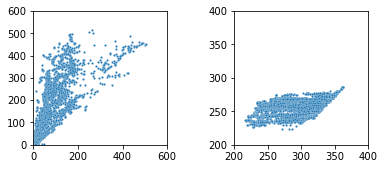

In [69]:
fig = plt.figure()
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)
plt.xlim(0,600)
plt.ylim(0,600)
plt.gca().set_aspect('equal', adjustable='box')
sns.scatterplot(x=Obs_SW_cs,y=Obs_SWclr_cs,s=5)

ax2 = plt.subplot(122,)
plt.xlim(200,400)
plt.ylim(200,400)
plt.gca().set_aspect('equal', adjustable='box')
sns.scatterplot(x=Obs_LW_cs,y=Obs_LWclr_cs,s=5)

<ipython-input-75-0f780afff5a9>:15: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
<ipython-input-75-0f780afff5a9>:32: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x2, y2, bins=25, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


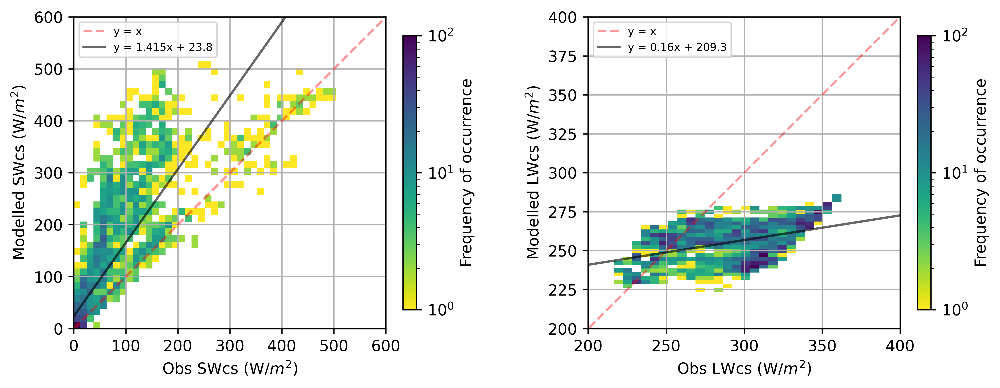

In [75]:
fig = plt.figure(figsize=(10,8), dpi=600)
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)

x1 = Obs_SW_cs
y1 = Obs_SWclr_cs
x = np.arange(600)

#plt.xlim(0,400)
#plt.ylim(0,400)
plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Obs SWcs (W/$m^{2}$)')
plt.ylabel('Modelled SWcs (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(0,600)
plt.ylim(0,600)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,1.415*x + 23.81,"-",color='black',alpha=0.6,label='y = 1.415x + 23.8')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

ax2 = plt.subplot(122,)

x2 = Obs_LW_cs
y2 = Obs_LWclr_cs

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Obs LWcs (W/$m^{2}$)')
plt.ylabel('Modelled LWcs (W/$m^{2}$)')
plt.hist2d(x2, y2, bins=25, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(200,400)
plt.ylim(200,400)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.1584*x + 209.3,"-",color='black',alpha=0.6,label='y = 0.16x + 209.3')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)
# plt.savefig('/Users/peizhangcheng/Desktop/SW&LW_radiation_scatter_ceres.jpg')

In [72]:
z1 = np.polyfit(x1, y1, 1)
p1 = np.poly1d(z1) 
print(p1)

z2 = np.polyfit(x2, y2, 1)
p2 = np.poly1d(z2) 
print(p2)

 
1.415 x + 23.81
 
0.1584 x + 209.3


In [6]:
stats.ttest_ind(Obs_SWclr.dropna(),ACCESS_SWclr.dropna())

Ttest_indResult(statistic=2.3825760758562815, pvalue=0.0173255592933585)

In [7]:
stats.ttest_ind(Obs_SWclr.dropna(),Sat_SWclr.dropna())

Ttest_indResult(statistic=2.08998508683394, pvalue=0.03680023733427798)

In [8]:
stats.ttest_ind(Obs_LWclr.dropna(),ACCESS_LWclr.dropna())

Ttest_indResult(statistic=7.22694419574478, pvalue=8.1139598645166e-13)

In [9]:
stats.ttest_ind(Obs_LWclr.dropna(),Sat_LWclr.dropna())

Ttest_indResult(statistic=8.314330822904017, pvalue=2.169470744906246e-16)

## Plots against timeseries

Text(0.5, 1.0, '(a) Cloud Radiative Effect (W/$m^{2}$)')

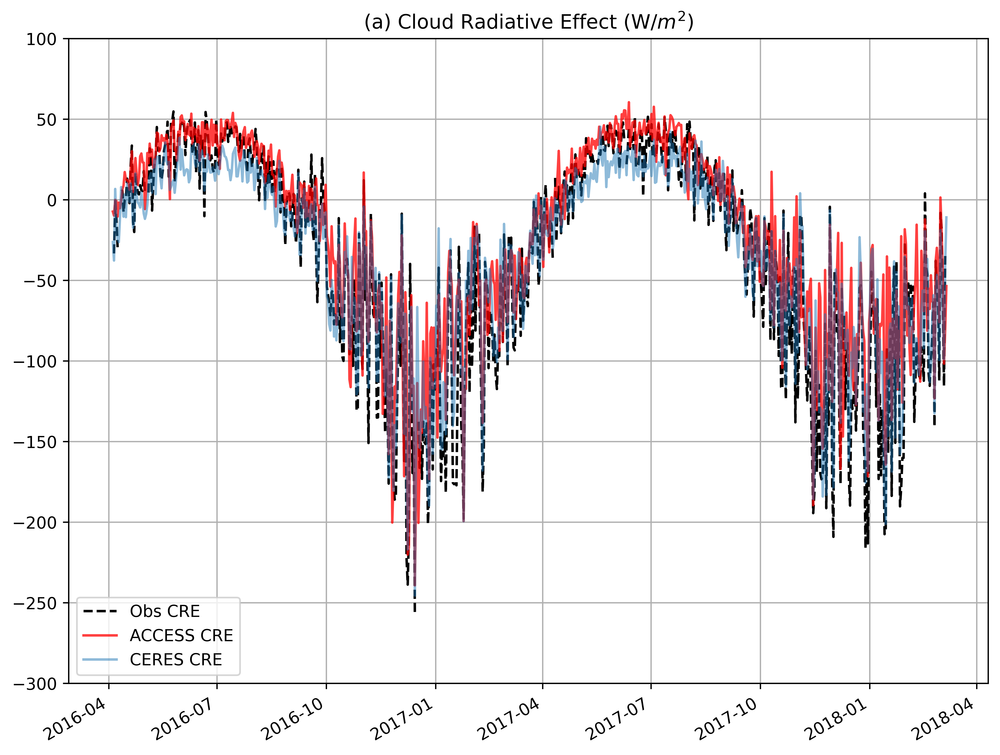

In [6]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax = plt.subplot()
Obs_CRE.plot(label='Obs CRE',color='black',linestyle='--');
ACCESS_CRE.plot(label='ACCESS CRE',color='red',alpha=0.75);
Sat_CRE.plot(label='CERES CRE',alpha=0.5)
plt.legend(loc='lower left');
plt.grid();
plt.ylim(-300,100)
plt.title('(a) Cloud Radiative Effect (W/$m^{2}$)')

# plt.savefig('/Users/peizhangcheng/Desktop/CRE_timeseries.jpg')

Text(0.5, 1.0, '(c) LW Cloud Radiative Effect (W/$m^{2}$)')

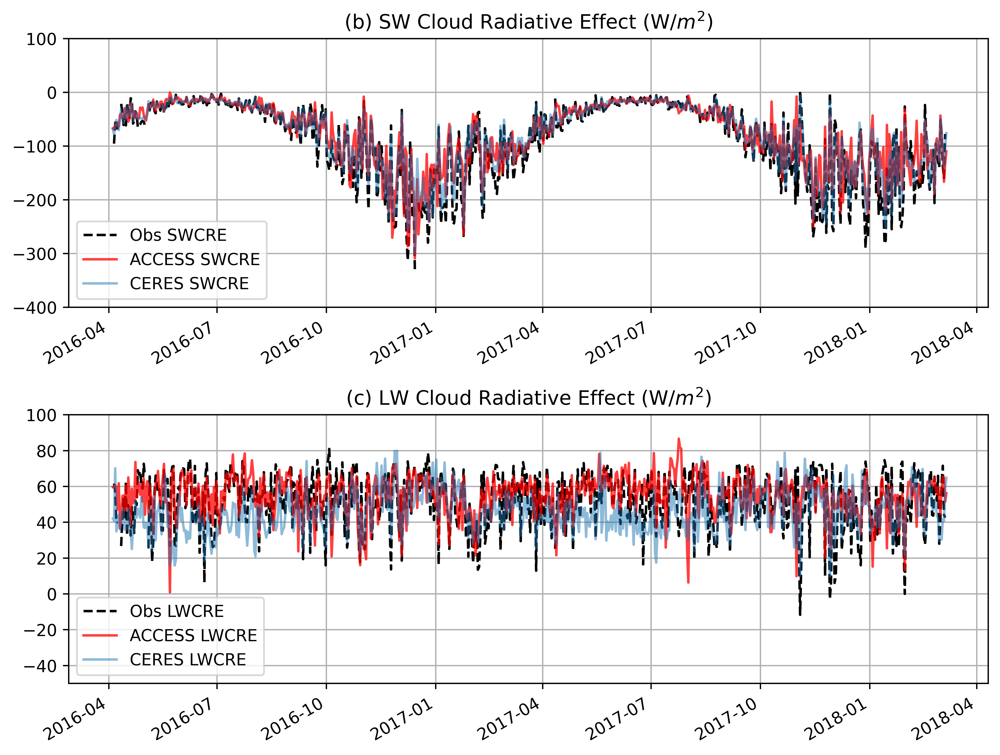

In [7]:
fig = plt.figure(figsize=(10,8),dpi=600)
plt.subplots_adjust(hspace=0.4)

ax1 = plt.subplot(211,)
Obs_SWCRE.plot(label='Obs SWCRE',color='black',linestyle='--');
ACCESS_SWCRE.plot(label='ACCESS SWCRE',color='red',alpha=0.75);
Sat_SWCRE.plot(label='CERES SWCRE',alpha=0.5);
plt.legend(loc='lower left');
plt.grid();
plt.ylim(-400,100)
plt.title('(b) SW Cloud Radiative Effect (W/$m^{2}$)')

ax2 = plt.subplot(212,)
Obs_LWCRE.plot(label='Obs LWCRE',color='black',linestyle='--');
ACCESS_LWCRE.plot(label='ACCESS LWCRE',color='red',alpha=0.75);
Sat_LWCRE.plot(label='CERES LWCRE',alpha=0.5);
plt.legend(loc='lower left');
plt.grid();
plt.ylim(-50,100)
plt.title('(c) LW Cloud Radiative Effect (W/$m^{2}$)')

# plt.savefig('/Users/peizhangcheng/Desktop/SW&LW_CRE_timeseries.jpg')

## Correlations

In [9]:
ACCESS_CRE = pd.Series(ACCESS_CRE, name='ACCESS CRE')
Obs_CRE = pd.Series(Obs_CRE, name='Obs CRE')
Sat_CRE = pd.Series(Sat_CRE, name='CERES CRE')
pd_CRE = pd.concat([ACCESS_CRE,Obs_CRE,Sat_CRE],axis=1)
pd_CRE.corr()

,ACCESS CRE,Obs CRE,CERES CRE
ACCESS CRE,1.000000,0.924624,0.923225
Obs CRE,0.924624,1.000000,0.972312
CERES CRE,0.923225,0.972312,1.000000


In [10]:
ACCESS_SWCRE = pd.Series(ACCESS_SWCRE, name='ACCESS SWCRE')
Obs_SWCRE = pd.Series(Obs_SWCRE, name='Obs SWCRE')
Sat_SWCRE = pd.Series(Sat_SWCRE, name='CERES SWCRE')
pd_SWCRE = pd.concat([ACCESS_SWCRE,Obs_SWCRE,Sat_SWCRE],axis=1)
pd_SWCRE.corr()

,ACCESS SWCRE,Obs SWCRE,CERES SWCRE
ACCESS SWCRE,1.000000,0.906461,0.917352
Obs SWCRE,0.906461,1.000000,0.982185
CERES SWCRE,0.917352,0.982185,1.000000


In [11]:
ACCESS_LWCRE = pd.Series(ACCESS_LWCRE, name='ACCESS LWCRE')
Obs_LWCRE = pd.Series(Obs_LWCRE, name='Obs LWCRE')
Sat_LWCRE = pd.Series(Sat_LWCRE, name='CERES LWCRE')
pd_LWCRE = pd.concat([ACCESS_LWCRE,Obs_LWCRE,Sat_LWCRE],axis=1)
pd_LWCRE.corr()

,ACCESS LWCRE,Obs LWCRE,CERES LWCRE
ACCESS LWCRE,1.000000,0.569694,0.374744
Obs LWCRE,0.569694,1.000000,0.451849
CERES LWCRE,0.374744,0.451849,1.000000


## Distributions

Text(0.5, 1.0, 'CRE distribution')

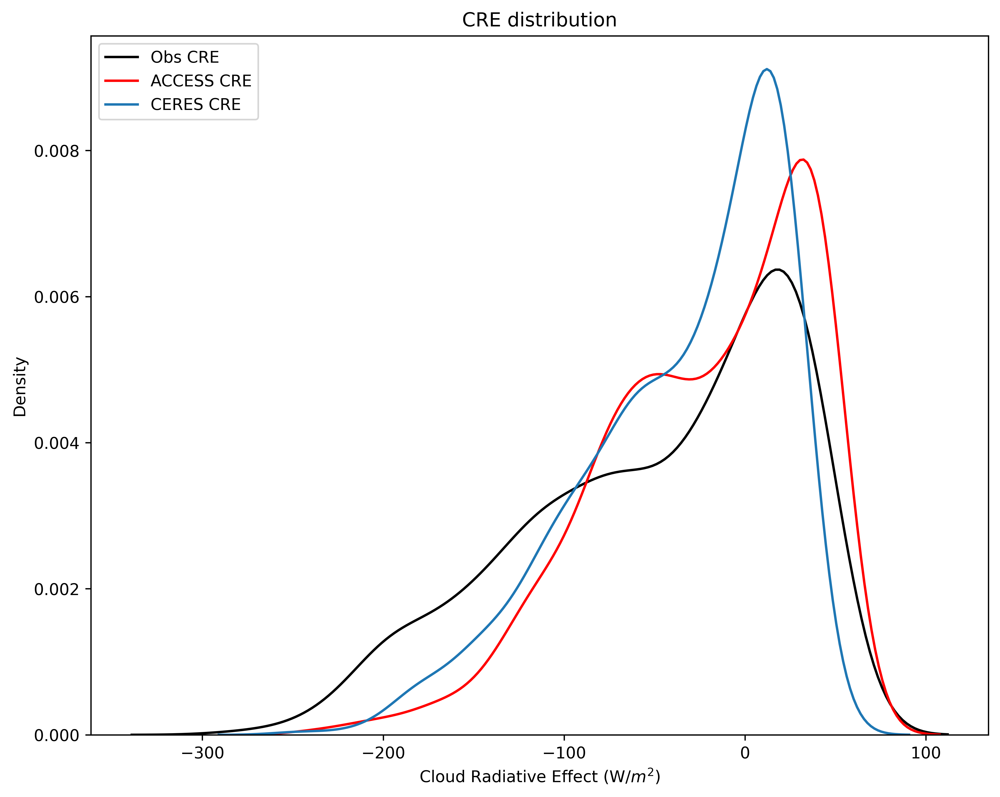

In [12]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax = plt.subplot()
sns.kdeplot(x=Obs_CRE, label='Obs CRE',color='black');
sns.kdeplot(x=ACCESS_CRE, label='ACCESS CRE',color='red')
sns.kdeplot(x=Sat_CRE, label='CERES CRE');
plt.legend(loc='upper left')
plt.xlabel('Cloud Radiative Effect (W/$m^{2}$)')
plt.title('CRE distribution')

#plt.savefig('/Users/peizhangcheng/Desktop/CRE_distribution.jpg')

Text(0.5, 0, 'LW Cloud Radiative Effect (W/$m^{2}$)')

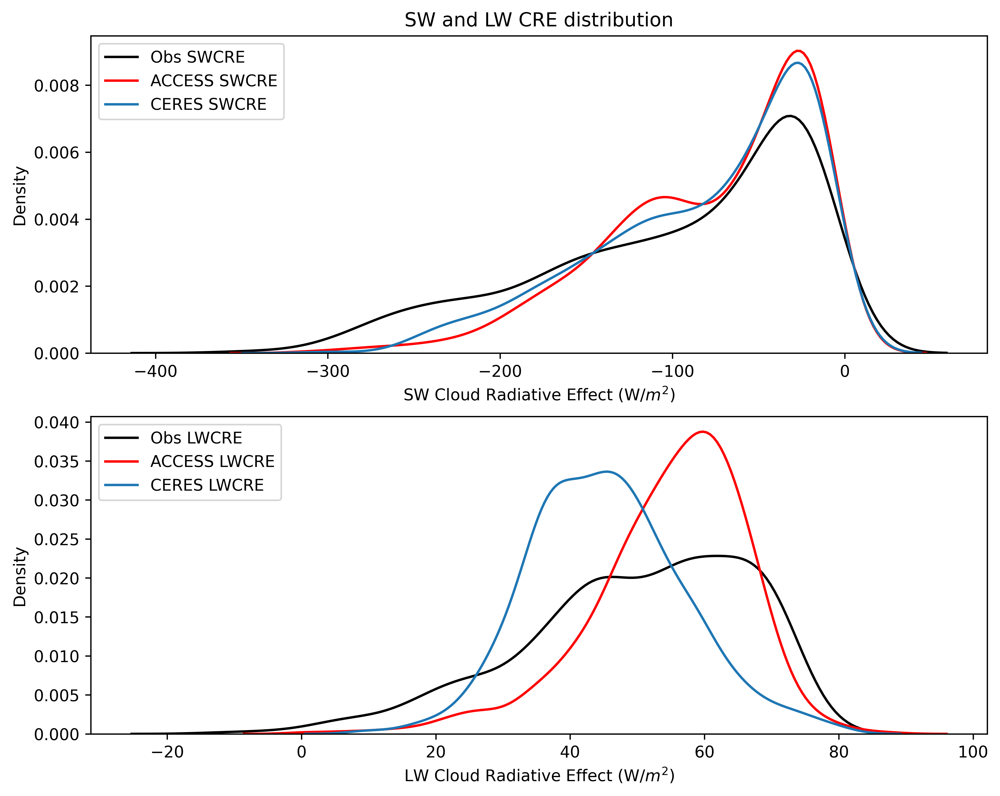

In [13]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax1 = plt.subplot(211,)
sns.kdeplot(x=Obs_SWCRE, label='Obs SWCRE',color='black');
sns.kdeplot(x=ACCESS_SWCRE, label='ACCESS SWCRE',color='red')
sns.kdeplot(x=Sat_SWCRE, label='CERES SWCRE');
plt.legend()
plt.xlabel('SW Cloud Radiative Effect (W/$m^{2}$)')
plt.title('SW and LW CRE distribution')

ax2 = plt.subplot(212,)
sns.kdeplot(x=Obs_LWCRE, label='Obs LWCRE',color='black');
sns.kdeplot(x=ACCESS_LWCRE, label='ACCESS LWCRE',color='red')
sns.kdeplot(x=Sat_LWCRE, label='CERES LWCRE');
plt.legend(loc='upper left')
plt.xlabel('LW Cloud Radiative Effect (W/$m^{2}$)')

# plt.savefig('/Users/peizhangcheng/Desktop/SW&LW_CRE_distribution.jpg')

## Scatters

In [14]:
ACCESS_CRE = ACCESS_CRE.where(Obs_SWCRE.isna()==False)
Obs_CRE = Obs_CRE.where(Obs_SWCRE.isna()==False)
Sat_CRE = Sat_CRE.where(Obs_SWCRE.isna()==False)
ACCESS_SWCRE = ACCESS_SWCRE.where(Obs_SWCRE.isna()==False)
Obs_SWCRE = Obs_SWCRE.where(Obs_SWCRE.isna()==False)
Sat_SWCRE = Sat_SWCRE.where(Obs_SWCRE.isna()==False)
ACCESS_LWCRE = ACCESS_LWCRE.where(Obs_SWCRE.isna()==False)
Obs_LWCRE = Obs_LWCRE.where(Obs_SWCRE.isna()==False)
Sat_LWCRE = Sat_LWCRE.where(Obs_SWCRE.isna()==False)
ACCESS_SWclr = ACCESS_SWclr.where(Obs_SWCRE.isna()==False)
Obs_SWclr = Obs_SWclr.where(Obs_SWCRE.isna()==False)
Sat_SWclr = Sat_SWclr.where(Obs_SWCRE.isna()==False)
ACCESS_LWclr = ACCESS_LWclr.where(Obs_SWCRE.isna()==False)
Obs_LWclr = Obs_LWclr.where(Obs_SWCRE.isna()==False)
Sat_LWclr = Sat_LWclr.where(Obs_SWCRE.isna()==False)

np_ACCESS_CRE = ACCESS_CRE.values
np_Obs_CRE = Obs_CRE.values
np_Sat_CRE = Sat_CRE.values
np_ACCESS_SWCRE = ACCESS_SWCRE.values
np_Obs_SWCRE = Obs_SWCRE.values
np_Sat_SWCRE = Sat_SWCRE.values
np_ACCESS_LWCRE = ACCESS_LWCRE.values
np_Obs_LWCRE = Obs_LWCRE.values
np_Sat_LWCRE = Sat_LWCRE.values
np_ACCESS_SWclr = ACCESS_SWclr.values
np_Obs_SWclr = Obs_SWclr.values
np_Sat_SWclr = Sat_SWclr.values
np_ACCESS_LWclr = ACCESS_LWclr.values
np_Obs_LWclr = Obs_LWclr.values
np_Sat_LWclr = Sat_LWclr.values

np_ACCESS_CRE = np_ACCESS_CRE[~pd.isna(np_ACCESS_CRE)]
np_Obs_CRE = np_Obs_CRE[~pd.isna(np_Obs_CRE)]
np_Sat_CRE = np_Sat_CRE[~pd.isna(np_Sat_CRE)]
np_ACCESS_SWCRE = np_ACCESS_SWCRE[~pd.isna(np_ACCESS_SWCRE)]
np_Obs_SWCRE = np_Obs_SWCRE[~pd.isna(np_Obs_SWCRE)]
np_Sat_SWCRE = np_Sat_SWCRE[~pd.isna(np_Sat_SWCRE)]
np_ACCESS_LWCRE = np_ACCESS_LWCRE[~pd.isna(np_ACCESS_LWCRE)]
np_Obs_LWCRE = np_Obs_LWCRE[~pd.isna(np_Obs_LWCRE)]
np_Sat_LWCRE = np_Sat_LWCRE[~pd.isna(np_Sat_LWCRE)]
np_ACCESS_SWclr = np_ACCESS_SWclr[~pd.isna(np_ACCESS_SWclr)]
np_Obs_SWclr = np_Obs_SWclr[~pd.isna(np_Obs_SWclr)]
np_Sat_SWclr = np_Sat_SWclr[~pd.isna(np_Sat_SWclr)]
np_ACCESS_LWclr = np_ACCESS_LWclr[~pd.isna(np_ACCESS_LWclr)]
np_Obs_LWclr = np_Obs_LWclr[~pd.isna(np_Obs_LWclr)]
np_Sat_LWclr = np_Sat_LWclr[~pd.isna(np_Sat_LWclr)]

<ipython-input-15-8616c6dcbdd8>:11: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


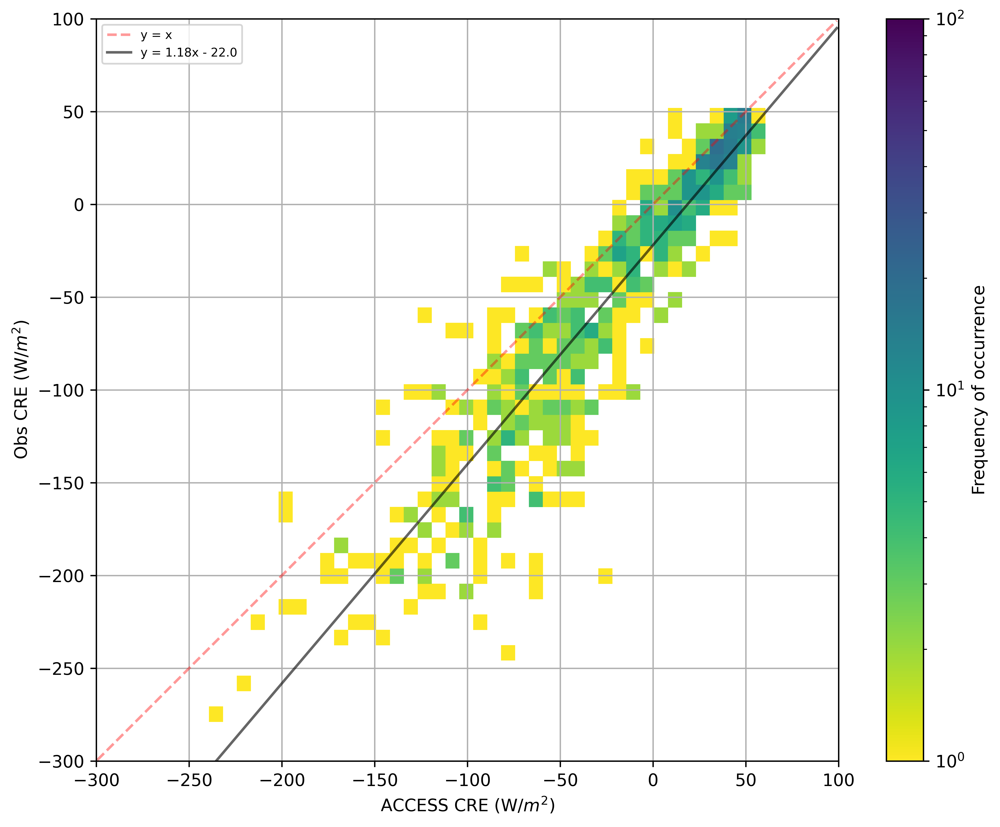

In [15]:
fig = plt.figure(figsize=(10,8), dpi=600)

ax = plt.subplot()

x1 = np_ACCESS_CRE
y1 = np_Obs_CRE
x = np.arange(-400,100)
plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS CRE (W/$m^{2}$)')
plt.ylabel('Obs CRE (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-300,100)
plt.ylim(-300,100)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,1.181*x - 21.95,"-",color='black',alpha=0.6,label='y = 1.18x - 22.0')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

<ipython-input-16-84138cac7d56>:11: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


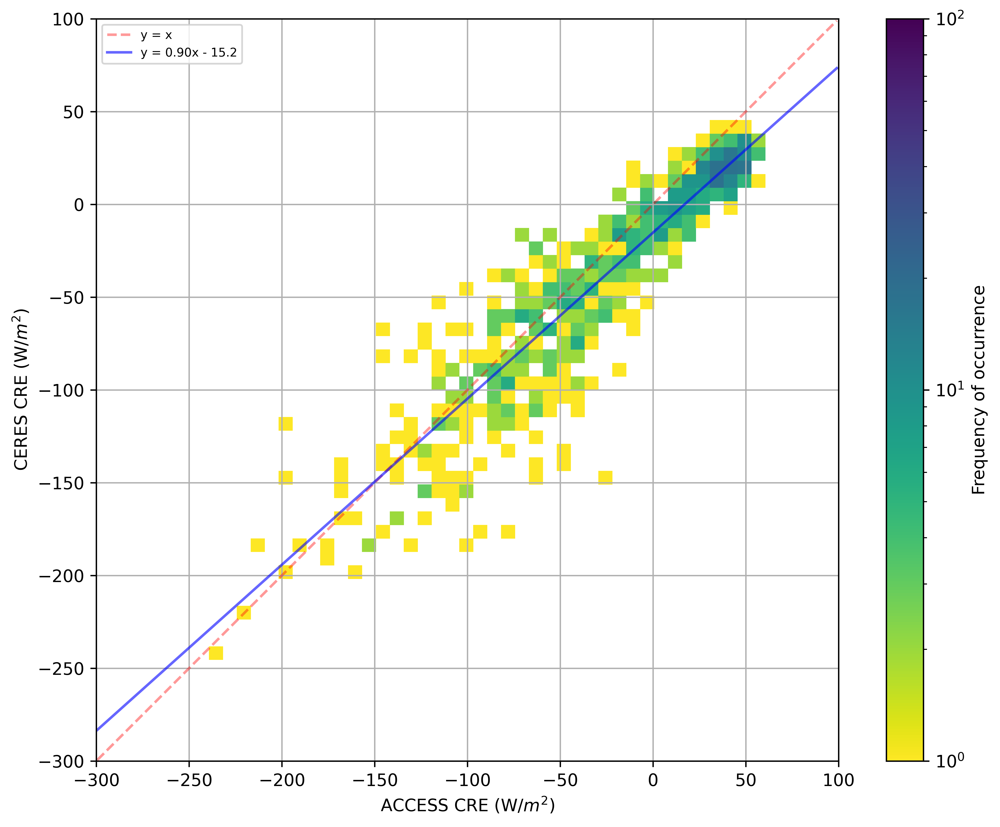

In [16]:
fig = plt.figure(figsize=(10,8), dpi=600)

ax = plt.subplot()

x1 = np_ACCESS_CRE
y1 = np_Sat_CRE
x = np.arange(-400,100)
plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS CRE (W/$m^{2}$)')
plt.ylabel('CERES CRE (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-300,100)
plt.ylim(-300,100)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.895*x - 15.22,"-",color='blue',alpha=0.6,label='y = 0.90x - 15.2')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

<ipython-input-17-e204b4f55754>:11: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


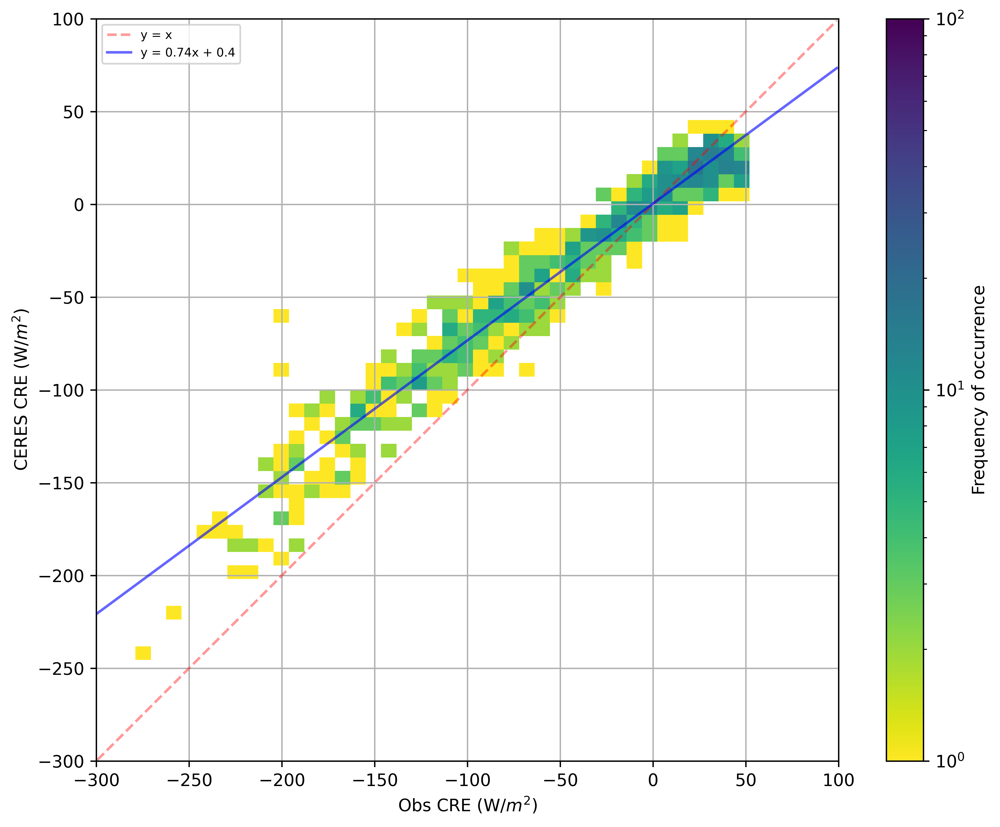

In [17]:
fig = plt.figure(figsize=(10,8), dpi=600)

ax = plt.subplot()

x1 = np_Obs_CRE
y1 = np_Sat_CRE
x = np.arange(-400,100)
plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Obs CRE (W/$m^{2}$)')
plt.ylabel('CERES CRE (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-300,100)
plt.ylim(-300,100)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.7374*x + 0.4196,"-",color='blue',alpha=0.6,label='y = 0.74x + 0.4')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

In [18]:
z1 = np.polyfit(x1, y1, 1)
p1 = np.poly1d(z1) 
print(p1)

 
0.7374 x + 0.4197


In [19]:
print(np.mean(np_ACCESS_CRE),np.mean(np_Obs_CRE),np.mean(np_Sat_CRE))

-22.684077455592593 -48.74159956802543 -35.52313238155748


In [20]:
print(np.std(np_ACCESS_CRE),np.std(np_Obs_CRE),np.std(np_Sat_CRE))

57.981307945039354 74.05591637372335 56.165013673749385


In [21]:
print(np.mean(np_ACCESS_SWCRE),np.mean(np_Obs_SWCRE),np.mean(np_Sat_SWCRE))

-77.42292717907246 -98.7730701237688 -80.899987609156


In [22]:
print(np.mean(np_ACCESS_LWCRE),np.mean(np_Obs_LWCRE),np.mean(np_Sat_LWCRE))

54.73884972347987 49.85239828822665 45.376855227598504


<ipython-input-23-5888b70d08d4>:13: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
<ipython-input-23-5888b70d08d4>:30: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x2, y2, bins=35, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


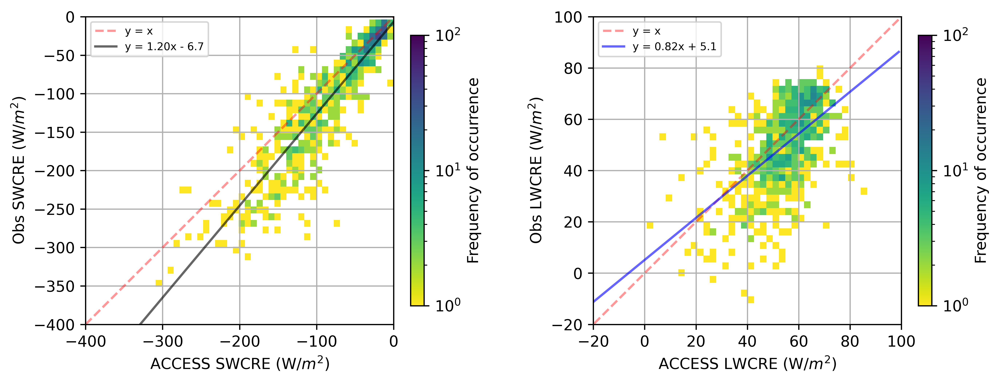

In [23]:
fig = plt.figure(figsize=(10,8), dpi=600)
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)

x1 = np_ACCESS_SWCRE
y1 = np_Obs_SWCRE
x = np.arange(-400,100)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS SWCRE (W/$m^{2}$)')
plt.ylabel('Obs SWCRE (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-400,0)
plt.ylim(-400,0)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,1.195*x - 6.656,"-",color='black',alpha=0.6,label='y = 1.20x - 6.7')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

ax2 = plt.subplot(122,)

x2 = np_ACCESS_LWCRE
y2 = np_Obs_LWCRE

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS LWCRE (W/$m^{2}$)')
plt.ylabel('Obs LWCRE (W/$m^{2}$)')
plt.hist2d(x2, y2, bins=35, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-20,100)
plt.ylim(-20,100)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.8195*x + 5.147,"-",color='blue',alpha=0.6,label='y = 0.82x + 5.1')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

In [24]:
z1 = np.polyfit(x1, y1, 1)
p1 = np.poly1d(z1) 
print(p1)

z2 = np.polyfit(x2, y2, 1)
p2 = np.poly1d(z2) 
print(p2)

 
1.195 x - 6.29
 
0.8195 x + 4.992


<ipython-input-25-a3fa9040f998>:13: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
<ipython-input-25-a3fa9040f998>:30: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x2, y2, bins=35, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


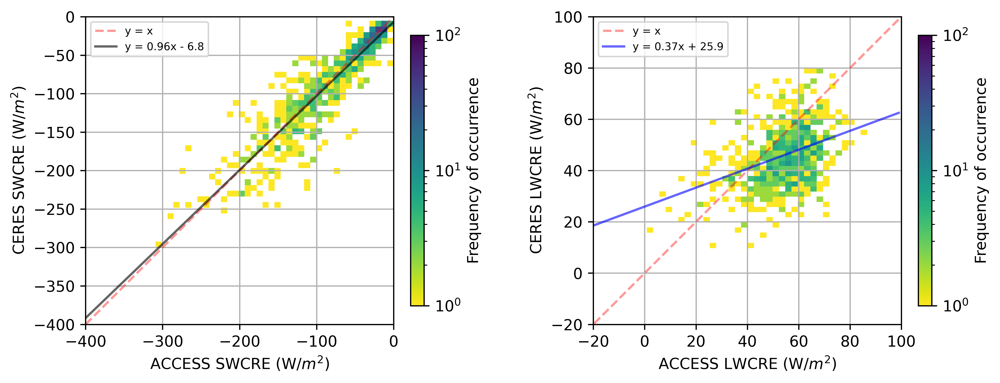

In [25]:
fig = plt.figure(figsize=(10,8), dpi=600)
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)

x1 = np_ACCESS_SWCRE
y1 = np_Sat_SWCRE
x = np.arange(-400,100)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS SWCRE (W/$m^{2}$)')
plt.ylabel('CERES SWCRE (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-400,0)
plt.ylim(-400,0)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.9625* x - 6.754,"-",color='black',alpha=0.6,label='y = 0.96x - 6.8')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

ax2 = plt.subplot(122,)

x2 = np_ACCESS_LWCRE
y2 = np_Sat_LWCRE

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS LWCRE (W/$m^{2}$)')
plt.ylabel('CERES LWCRE (W/$m^{2}$)')
plt.hist2d(x2, y2, bins=35, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-20,100)
plt.ylim(-20,100)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.3694*x + 25.94,"-",color='blue',alpha=0.6,label='y = 0.37x + 25.9')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

<ipython-input-26-43b58c91e019>:13: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
<ipython-input-26-43b58c91e019>:30: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x2, y2, bins=35, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


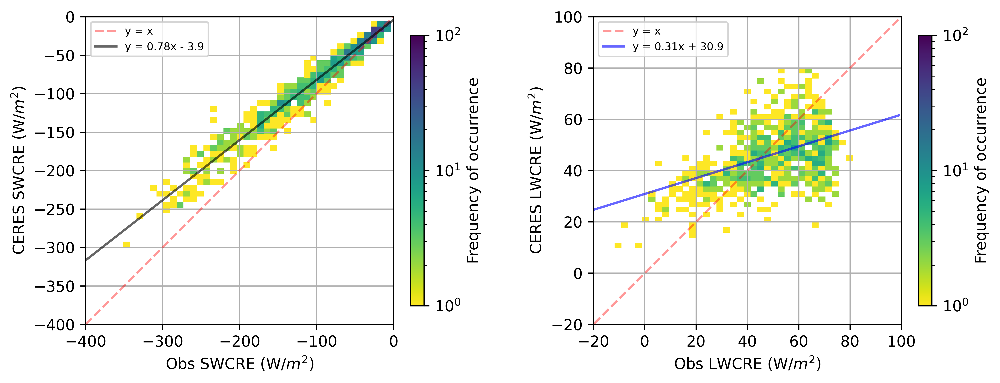

In [26]:
fig = plt.figure(figsize=(10,8), dpi=600)
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)

x1 = np_Obs_SWCRE
y1 = np_Sat_SWCRE
x = np.arange(-400,100)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Obs SWCRE (W/$m^{2}$)')
plt.ylabel('CERES SWCRE (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-400,0)
plt.ylim(-400,0)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.7822*x - 3.854,"-",color='black',alpha=0.6,label='y = 0.78x - 3.9')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

ax2 = plt.subplot(122,)

x2 = np_Obs_LWCRE
y2 = np_Sat_LWCRE

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Obs LWCRE (W/$m^{2}$)')
plt.ylabel('CERES LWCRE (W/$m^{2}$)')
plt.hist2d(x2, y2, bins=35, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(-20,100)
plt.ylim(-20,100)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.3095*x + 30.87,"-",color='blue',alpha=0.6,label='y = 0.31x + 30.9')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

In [27]:
print(np.mean(np_ACCESS_SWCRE),np.mean(np_Obs_SWCRE),np.mean(np_Sat_SWCRE))

-77.42292717907246 -98.7730701237688 -80.899987609156


In [28]:
print(np.std(np_ACCESS_SWCRE),np.std(np_Obs_SWCRE),np.std(np_Sat_SWCRE))

58.670858169246394 77.31552460421388 61.57132443088158


In [29]:
print(np.mean(np_ACCESS_LWCRE),np.mean(np_Obs_LWCRE),np.mean(np_Sat_LWCRE))

54.73884972347987 49.85239828822665 45.376855227598504


In [30]:
print(np.std(np_ACCESS_LWCRE),np.std(np_Obs_LWCRE),np.std(np_Sat_LWCRE))

11.621720099044838 16.718279383247715 11.452469850916813


## Histograms

Text(0, 0.5, 'Density')

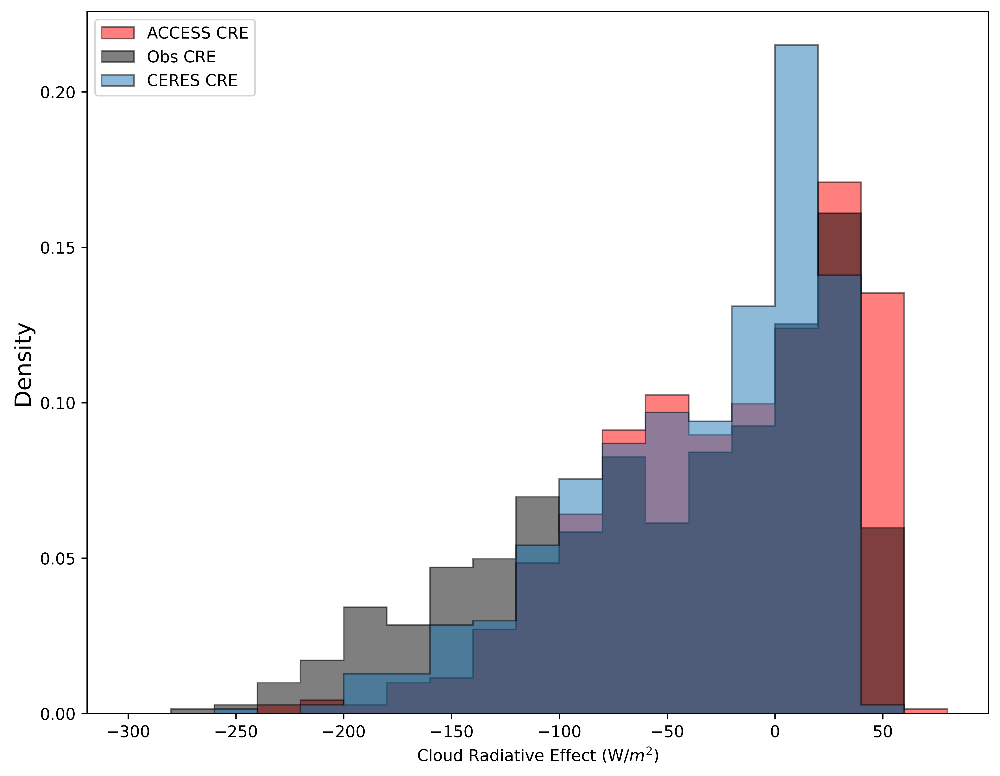

In [31]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax = plt.subplot()
weights1 = np.ones_like(ACCESS_CRE) / len(ACCESS_CRE)
weights2 = np.ones_like(Obs_CRE) / len(Obs_CRE)
weights3 = np.ones_like(Sat_CRE) / len(Sat_CRE)

plt.hist(ACCESS_CRE, weights=weights1, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, color = 'red', edgecolor='black', label='ACCESS CRE')
plt.hist(Obs_CRE, weights=weights2, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, color = 'black', edgecolor='black', label='Obs CRE')
plt.hist(Sat_CRE, weights=weights3, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, edgecolor='black', label='CERES CRE')
plt.legend(loc='upper left')
plt.xlabel('Cloud Radiative Effect (W/$m^{2}$)')
ax.set_ylabel("Density", fontsize=14)

Text(172.00000000000003, 0.5, 'Density')

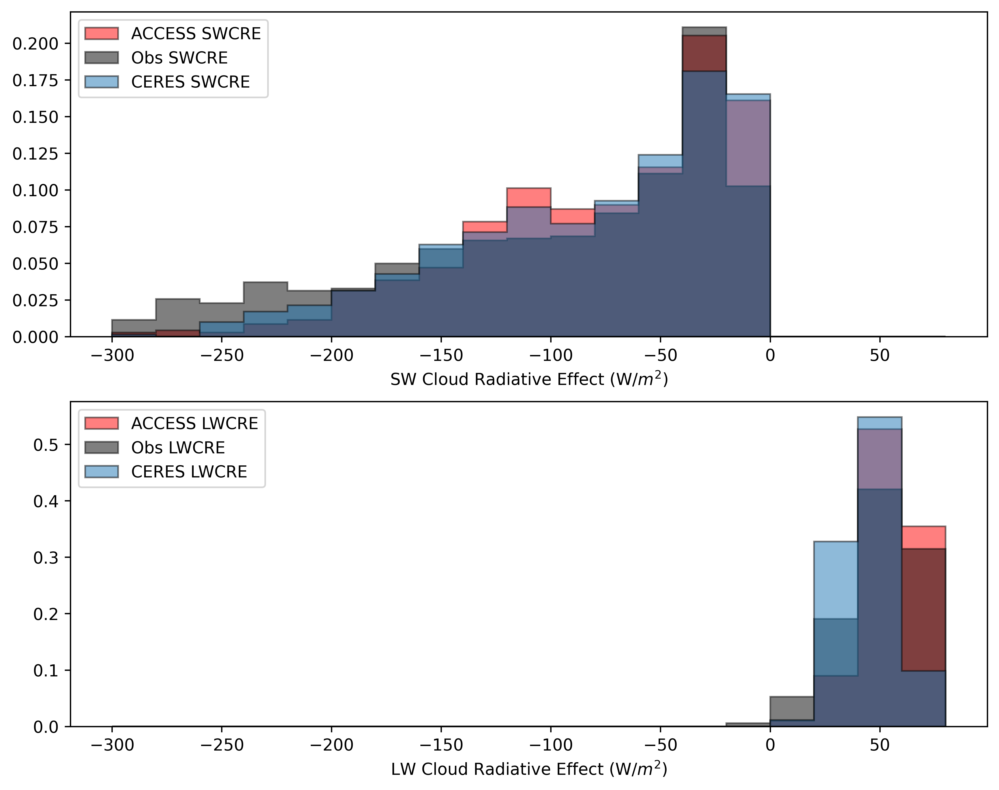

In [32]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax1 = plt.subplot(211,)
weights1 = np.ones_like(ACCESS_SWCRE) / len(ACCESS_SWCRE)
weights2 = np.ones_like(Obs_SWCRE) / len(Obs_SWCRE)
weights3 = np.ones_like(Sat_SWCRE) / len(Sat_SWCRE)

plt.hist(ACCESS_SWCRE, weights=weights1, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, color = 'red', edgecolor='black', label='ACCESS SWCRE')
plt.hist(Obs_SWCRE, weights=weights2, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, color = 'black', edgecolor='black', label='Obs SWCRE')
plt.hist(Sat_SWCRE, weights=weights3, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, edgecolor='black', label='CERES SWCRE')
plt.legend(loc='upper left')
plt.xlabel('SW Cloud Radiative Effect (W/$m^{2}$)')
ax.set_ylabel("Density", fontsize=14)

ax2 = plt.subplot(212,)
weights4 = np.ones_like(ACCESS_LWCRE) / len(ACCESS_LWCRE)
weights5 = np.ones_like(Obs_LWCRE) / len(Obs_LWCRE)
weights6 = np.ones_like(Sat_LWCRE) / len(Sat_LWCRE)

plt.hist(ACCESS_LWCRE, weights=weights4, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, color = 'red', edgecolor='black', label='ACCESS LWCRE')
plt.hist(Obs_LWCRE, weights=weights5, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, color = 'black', edgecolor='black', label='Obs LWCRE')
plt.hist(Sat_LWCRE, weights=weights6, bins=np.arange(-300,100,20), histtype="stepfilled", alpha=0.5, edgecolor='black', label='CERES LWCRE')
plt.legend(loc='upper left')
plt.xlabel('LW Cloud Radiative Effect (W/$m^{2}$)')
ax.set_ylabel("Density", fontsize=14)

## Remove seasonal effect

### Add seasons into pandas dataframe

In [33]:
season = pd.Series(name='Season',dtype='string')
ACCESS_SWCRE = pd.Series(ACCESS_SWCRE,name="ACCESS_SW_CRE")
ACCESS_LWCRE = pd.Series(ACCESS_LWCRE,name="ACCESS_LW_CRE")
Obs_SWCRE = pd.Series(Obs_SWCRE,name="Obs_SW_CRE")
Obs_LWCRE = pd.Series(Obs_LWCRE,name="Obs_LW_CRE")
Sat_SWCRE = pd.Series(Sat_SWCRE,name="CERES_SW_CRE")
Sat_LWCRE = pd.Series(Sat_LWCRE,name="CERES_LW_CRE")
Obs_SWCRE_season = pd.concat([Obs_SWCRE,season],axis=1)
ACCESS_SWCRE_season = pd.concat([ACCESS_SWCRE,season],axis=1)
Sat_SWCRE_season = pd.concat([Sat_SWCRE,season],axis=1)
Obs_LWCRE_season = pd.concat([Obs_LWCRE,season],axis=1)
ACCESS_LWCRE_season = pd.concat([ACCESS_LWCRE,season],axis=1)
Sat_LWCRE_season = pd.concat([Sat_LWCRE,season],axis=1)

### Identify seasons

In [34]:
for row in Obs_SWCRE_season.index:
    if (str(row)[5:7] == str(12).rjust(2,'0')) or (str(row)[5:7] == str(1).rjust(2,'0')) or (str(row)[5:7] == str(2).rjust(2,'0')):
        Obs_SWCRE_season['Season'][row] = 'DJF'
    elif (str(row)[5:7] == str(3).rjust(2,'0')) or (str(row)[5:7] == str(4).rjust(2,'0')) or (str(row)[5:7] == str(5).rjust(2,'0')):
        Obs_SWCRE_season['Season'][row] = 'MAM'
    elif (str(row)[5:7] == str(6).rjust(2,'0')) or (str(row)[5:7] == str(7).rjust(2,'0')) or (str(row)[5:7] == str(8).rjust(2,'0')):
        Obs_SWCRE_season['Season'][row] = 'JJA'
    else:
        Obs_SWCRE_season['Season'][row] = 'SON'
        
for row in ACCESS_SWCRE_season.index:
    if (str(row)[5:7] == str(12).rjust(2,'0')) or (str(row)[5:7] == str(1).rjust(2,'0')) or (str(row)[5:7] == str(2).rjust(2,'0')):
        ACCESS_SWCRE_season['Season'][row] = 'DJF'
    elif (str(row)[5:7] == str(3).rjust(2,'0')) or (str(row)[5:7] == str(4).rjust(2,'0')) or (str(row)[5:7] == str(5).rjust(2,'0')):
        ACCESS_SWCRE_season['Season'][row] = 'MAM'
    elif (str(row)[5:7] == str(6).rjust(2,'0')) or (str(row)[5:7] == str(7).rjust(2,'0')) or (str(row)[5:7] == str(8).rjust(2,'0')):
        ACCESS_SWCRE_season['Season'][row] = 'JJA'
    else:
        ACCESS_SWCRE_season['Season'][row] = 'SON'

for row in Sat_SWCRE_season.index:
    if (str(row)[5:7] == str(12).rjust(2,'0')) or (str(row)[5:7] == str(1).rjust(2,'0')) or (str(row)[5:7] == str(2).rjust(2,'0')):
        Sat_SWCRE_season['Season'][row] = 'DJF'
    elif (str(row)[5:7] == str(3).rjust(2,'0')) or (str(row)[5:7] == str(4).rjust(2,'0')) or (str(row)[5:7] == str(5).rjust(2,'0')):
        Sat_SWCRE_season['Season'][row] = 'MAM'
    elif (str(row)[5:7] == str(6).rjust(2,'0')) or (str(row)[5:7] == str(7).rjust(2,'0')) or (str(row)[5:7] == str(8).rjust(2,'0')):
        Sat_SWCRE_season['Season'][row] = 'JJA'
    else:
        Sat_SWCRE_season['Season'][row] = 'SON'
        
for row in Obs_LWCRE_season.index:
    if (str(row)[5:7] == str(12).rjust(2,'0')) or (str(row)[5:7] == str(1).rjust(2,'0')) or (str(row)[5:7] == str(2).rjust(2,'0')):
        Obs_LWCRE_season['Season'][row] = 'DJF'
    elif (str(row)[5:7] == str(3).rjust(2,'0')) or (str(row)[5:7] == str(4).rjust(2,'0')) or (str(row)[5:7] == str(5).rjust(2,'0')):
        Obs_LWCRE_season['Season'][row] = 'MAM'
    elif (str(row)[5:7] == str(6).rjust(2,'0')) or (str(row)[5:7] == str(7).rjust(2,'0')) or (str(row)[5:7] == str(8).rjust(2,'0')):
        Obs_LWCRE_season['Season'][row] = 'JJA'
    else:
        Obs_LWCRE_season['Season'][row] = 'SON'
        
for row in ACCESS_LWCRE_season.index:
    if (str(row)[5:7] == str(12).rjust(2,'0')) or (str(row)[5:7] == str(1).rjust(2,'0')) or (str(row)[5:7] == str(2).rjust(2,'0')):
        ACCESS_LWCRE_season['Season'][row] = 'DJF'
    elif (str(row)[5:7] == str(3).rjust(2,'0')) or (str(row)[5:7] == str(4).rjust(2,'0')) or (str(row)[5:7] == str(5).rjust(2,'0')):
        ACCESS_LWCRE_season['Season'][row] = 'MAM'
    elif (str(row)[5:7] == str(6).rjust(2,'0')) or (str(row)[5:7] == str(7).rjust(2,'0')) or (str(row)[5:7] == str(8).rjust(2,'0')):
        ACCESS_LWCRE_season['Season'][row] = 'JJA'
    else:
        ACCESS_LWCRE_season['Season'][row] = 'SON'
        
for row in Sat_LWCRE_season.index:
    if (str(row)[5:7] == str(12).rjust(2,'0')) or (str(row)[5:7] == str(1).rjust(2,'0')) or (str(row)[5:7] == str(2).rjust(2,'0')):
        Sat_LWCRE_season['Season'][row] = 'DJF'
    elif (str(row)[5:7] == str(3).rjust(2,'0')) or (str(row)[5:7] == str(4).rjust(2,'0')) or (str(row)[5:7] == str(5).rjust(2,'0')):
        Sat_LWCRE_season['Season'][row] = 'MAM'
    elif (str(row)[5:7] == str(6).rjust(2,'0')) or (str(row)[5:7] == str(7).rjust(2,'0')) or (str(row)[5:7] == str(8).rjust(2,'0')):
        Sat_LWCRE_season['Season'][row] = 'JJA'
    else:
        Sat_LWCRE_season['Season'][row] = 'SON'

### Calculate the seasonal means

In [35]:
Obs_SWCRE_season.groupby('Season').mean()

,Obs_SW_CRE
Season,
DJF,-175.046063
JJA,-28.137250
MAM,-58.456953
SON,-128.206388


In [36]:
ACCESS_SWCRE_season.groupby('Season').mean()

,ACCESS_SW_CRE
Season,
DJF,-134.372157
JJA,-24.454872
MAM,-48.075327
SON,-99.010749


In [37]:
Sat_SWCRE_season.groupby('Season').mean()

,CERES_SW_CRE
Season,
DJF,-141.131514
JJA,-23.925917
MAM,-48.509941
SON,-105.796472


In [38]:
Obs_LWCRE_season.groupby('Season').mean()

,Obs_LW_CRE
Season,
DJF,47.339899
JJA,50.989010
MAM,51.177589
SON,50.081913


In [39]:
ACCESS_LWCRE_season.groupby('Season').mean()

,ACCESS_LW_CRE
Season,
DJF,51.630402
JJA,58.432152
MAM,55.278633
SON,53.623475


In [40]:
Sat_LWCRE_season.groupby('Season').mean()

,CERES_LW_CRE
Season,
DJF,48.739963
JJA,40.628442
MAM,43.016854
SON,48.794253


### Remove seasonal effect

In [41]:
for row in np.arange(len(Obs_SWCRE_season)):
    if Obs_SWCRE_season['Season'][row] == 'DJF':
        Obs_SWCRE_season['Obs_SW_CRE'][row] = Obs_SWCRE_season['Obs_SW_CRE'][row] + 185.234
    elif Obs_SWCRE_season['Season'][row] == 'JJA':
        Obs_SWCRE_season['Obs_SW_CRE'][row] = Obs_SWCRE_season['Obs_SW_CRE'][row] + 29.775
    elif Obs_SWCRE_season['Season'][row] == 'MAM':
        Obs_SWCRE_season['Obs_SW_CRE'][row] = Obs_SWCRE_season['Obs_SW_CRE'][row] + 61.996
    else:
        Obs_SWCRE_season['Obs_SW_CRE'][row] = Obs_SWCRE_season['Obs_SW_CRE'][row] + 135.668

<ipython-input-41-d9d6f37abc18>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Obs_SWCRE_season['Obs_SW_CRE'][row] = Obs_SWCRE_season['Obs_SW_CRE'][row] + 61.996
<ipython-input-41-d9d6f37abc18>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Obs_SWCRE_season['Obs_SW_CRE'][row] = Obs_SWCRE_season['Obs_SW_CRE'][row] + 29.775
<ipython-input-41-d9d6f37abc18>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Obs_SWCRE_season['Obs_SW_CRE']

In [42]:
for row in np.arange(len(ACCESS_SWCRE_season)):
    if ACCESS_SWCRE_season['Season'][row] == 'DJF':
        ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] = ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] + 142.193
    elif ACCESS_SWCRE_season['Season'][row] == 'JJA':
        ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] = ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] + 25.878
    elif ACCESS_SWCRE_season['Season'][row] == 'MAM':
        ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] = ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] + 50.873
    else:
        ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] = ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] + 104.773

<ipython-input-42-3a0fcd7e2439>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] = ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] + 50.873
<ipython-input-42-3a0fcd7e2439>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] = ACCESS_SWCRE_season['ACCESS_SW_CRE'][row] + 25.878
<ipython-input-42-3a0fcd7e2439>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACCESS

In [43]:
for row in np.arange(len(Sat_SWCRE_season)):
    if Sat_SWCRE_season['Season'][row] == 'DJF':
        Sat_SWCRE_season['CERES_SW_CRE'][row] = Sat_SWCRE_season['CERES_SW_CRE'][row] + 149.699
    elif Sat_SWCRE_season['Season'][row] == 'JJA':
        Sat_SWCRE_season['CERES_SW_CRE'][row] = Sat_SWCRE_season['CERES_SW_CRE'][row] + 25.284
    elif Sat_SWCRE_season['Season'][row] == 'MAM':
        Sat_SWCRE_season['CERES_SW_CRE'][row] = Sat_SWCRE_season['CERES_SW_CRE'][row] + 51.818
    else:
        Sat_SWCRE_season['CERES_SW_CRE'][row] = Sat_SWCRE_season['CERES_SW_CRE'][row] + 111.954

<ipython-input-43-6e0474e29656>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Sat_SWCRE_season['CERES_SW_CRE'][row] = Sat_SWCRE_season['CERES_SW_CRE'][row] + 51.818
<ipython-input-43-6e0474e29656>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Sat_SWCRE_season['CERES_SW_CRE'][row] = Sat_SWCRE_season['CERES_SW_CRE'][row] + 25.284
<ipython-input-43-6e0474e29656>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Sat_SWCRE_season['CERE

In [44]:
for row in np.arange(len(Obs_LWCRE_season)):
    if Obs_LWCRE_season['Season'][row] == 'DJF':
        Obs_LWCRE_season['Obs_LW_CRE'][row] = Obs_LWCRE_season['Obs_LW_CRE'][row] - 48.804
    elif Obs_LWCRE_season['Season'][row] == 'JJA':
        Obs_LWCRE_season['Obs_LW_CRE'][row] = Obs_LWCRE_season['Obs_LW_CRE'][row] - 52.566
    elif Obs_LWCRE_season['Season'][row] == 'MAM':
        Obs_LWCRE_season['Obs_LW_CRE'][row] = Obs_LWCRE_season['Obs_LW_CRE'][row] - 52.775
    else:
        Obs_LWCRE_season['Obs_LW_CRE'][row] = Obs_LWCRE_season['Obs_LW_CRE'][row] - 51.631

<ipython-input-44-cd28315f59b7>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Obs_LWCRE_season['Obs_LW_CRE'][row] = Obs_LWCRE_season['Obs_LW_CRE'][row] - 52.775
<ipython-input-44-cd28315f59b7>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Obs_LWCRE_season['Obs_LW_CRE'][row] = Obs_LWCRE_season['Obs_LW_CRE'][row] - 52.566
<ipython-input-44-cd28315f59b7>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Obs_LWCRE_season['Obs_LW_CRE']

In [45]:
for row in np.arange(len(ACCESS_LWCRE_season)):
    if ACCESS_LWCRE_season['Season'][row] == 'DJF':
        ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] = ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] - 53.227
    elif ACCESS_LWCRE_season['Season'][row] == 'JJA':
        ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] = ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] - 60.239
    elif ACCESS_LWCRE_season['Season'][row] == 'MAM':
        ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] = ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] - 56.988
    else:
        ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] = ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] - 55.282

<ipython-input-45-87ab32795509>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] = ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] - 56.988
<ipython-input-45-87ab32795509>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] = ACCESS_LWCRE_season['ACCESS_LW_CRE'][row] - 60.239
<ipython-input-45-87ab32795509>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ACCESS

In [46]:
for row in np.arange(len(Sat_LWCRE_season)):
    if Sat_LWCRE_season['Season'][row] == 'DJF':
        Sat_LWCRE_season['CERES_LW_CRE'][row] = Sat_LWCRE_season['CERES_LW_CRE'][row] - 50.386
    elif Sat_LWCRE_season['Season'][row] == 'JJA':
        Sat_LWCRE_season['CERES_LW_CRE'][row] = Sat_LWCRE_season['CERES_LW_CRE'][row] - 41.928
    elif Sat_LWCRE_season['Season'][row] == 'MAM':
        Sat_LWCRE_season['CERES_LW_CRE'][row] = Sat_LWCRE_season['CERES_LW_CRE'][row] - 44.335
    else:
        Sat_LWCRE_season['CERES_LW_CRE'][row] = Sat_LWCRE_season['CERES_LW_CRE'][row] - 50.303

<ipython-input-46-5fecae59f085>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Sat_LWCRE_season['CERES_LW_CRE'][row] = Sat_LWCRE_season['CERES_LW_CRE'][row] - 44.335
<ipython-input-46-5fecae59f085>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Sat_LWCRE_season['CERES_LW_CRE'][row] = Sat_LWCRE_season['CERES_LW_CRE'][row] - 41.928
<ipython-input-46-5fecae59f085>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Sat_LWCRE_season['CERE

### Plots against timeseries

Text(0.5, 1.0, 'LW Cloud Radiative Effect (W/$m^{2}$) (Remove Seasonal Effect)')

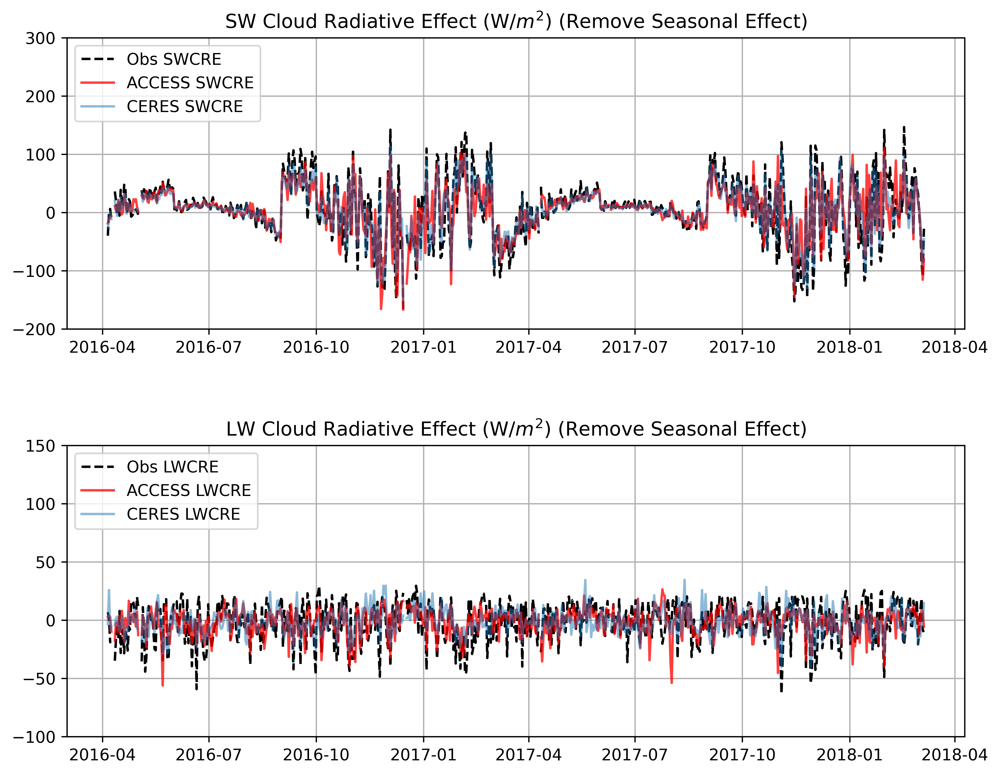

In [47]:
fig = plt.figure(figsize=(10,8),dpi=600)
plt.subplots_adjust(hspace=0.4)

ax1 = plt.subplot(211,)
ax1.plot(Obs_SWCRE_season['Obs_SW_CRE'], label='Obs SWCRE',color='black',linestyle='--');
ax1.plot(ACCESS_SWCRE_season['ACCESS_SW_CRE'], label='ACCESS SWCRE',color='red',alpha=0.75);
ax1.plot(Sat_SWCRE_season['CERES_SW_CRE'], label='CERES SWCRE',alpha=0.5);
plt.legend(loc='upper left');
plt.grid();
plt.ylim(-200,300)
plt.title('SW Cloud Radiative Effect (W/$m^{2}$) (Remove Seasonal Effect)')

ax2 = plt.subplot(212,)
ax2.plot(Obs_LWCRE_season['Obs_LW_CRE'], label='Obs LWCRE',color='black',linestyle='--');
ax2.plot(ACCESS_LWCRE_season['ACCESS_LW_CRE'], label='ACCESS LWCRE',color='red',alpha=0.75);
ax2.plot(Sat_LWCRE_season['CERES_LW_CRE'], label='CERES LWCRE',alpha=0.5);
plt.legend(loc='upper left');
plt.grid();
plt.ylim(-100,150)
plt.title('LW Cloud Radiative Effect (W/$m^{2}$) (Remove Seasonal Effect)')

### Correlations

In [48]:
pd_SWCRE_season = pd.concat([ACCESS_SWCRE_season['ACCESS_SW_CRE'],Obs_SWCRE_season['Obs_SW_CRE'],Sat_SWCRE_season['CERES_SW_CRE']],axis=1)
pd_SWCRE_season.corr()

,ACCESS_SW_CRE,Obs_SW_CRE,CERES_SW_CRE
ACCESS_SW_CRE,1.000000,0.789953,0.813067
Obs_SW_CRE,0.789953,1.000000,0.958884
CERES_SW_CRE,0.813067,0.958884,1.000000


In [49]:
pd_LWCRE_season = pd.concat([ACCESS_LWCRE_season['ACCESS_LW_CRE'],Obs_LWCRE_season['Obs_LW_CRE'],Sat_LWCRE_season['CERES_LW_CRE']],axis=1)
pd_LWCRE_season.corr()

,ACCESS_LW_CRE,Obs_LW_CRE,CERES_LW_CRE
ACCESS_LW_CRE,1.000000,0.569375,0.474709
Obs_LW_CRE,0.569375,1.000000,0.500776
CERES_LW_CRE,0.474709,0.500776,1.000000


## Make Seasonal plots

In [50]:
DJF_obs_CRE = pd.concat([Obs_CRE['2016-12':'2017-02'],Obs_CRE['2017-12':'2018-02']],axis=0)
MAM_obs_CRE = pd.concat([Obs_CRE['2016-04':'2016-05'],Obs_CRE['2017-03':'2017-05'],Obs_CRE['2018-03']],axis=0)
JJA_obs_CRE = pd.concat([Obs_CRE['2016-06':'2016-08'],Obs_CRE['2017-06':'2017-08']],axis=0)
SON_obs_CRE = pd.concat([Obs_CRE['2016-09':'2016-11'],Obs_CRE['2017-09':'2017-11']],axis=0)

DJF_obs_SWCRE = pd.concat([Obs_SWCRE['2016-12':'2017-02'],Obs_SWCRE['2017-12':'2018-02']],axis=0)
MAM_obs_SWCRE = pd.concat([Obs_SWCRE['2016-04':'2016-05'],Obs_SWCRE['2017-03':'2017-05'],Obs_SWCRE['2018-03']],axis=0)
JJA_obs_SWCRE = pd.concat([Obs_SWCRE['2016-06':'2016-08'],Obs_SWCRE['2017-06':'2017-08']],axis=0)
SON_obs_SWCRE = pd.concat([Obs_SWCRE['2016-09':'2016-11'],Obs_SWCRE['2017-09':'2017-11']],axis=0)

DJF_obs_LWCRE = pd.concat([Obs_LWCRE['2016-12':'2017-02'],Obs_LWCRE['2017-12':'2018-02']],axis=0)
MAM_obs_LWCRE = pd.concat([Obs_LWCRE['2016-04':'2016-05'],Obs_LWCRE['2017-03':'2017-05'],Obs_LWCRE['2018-03']],axis=0)
JJA_obs_LWCRE = pd.concat([Obs_LWCRE['2016-06':'2016-08'],Obs_LWCRE['2017-06':'2017-08']],axis=0)
SON_obs_LWCRE = pd.concat([Obs_LWCRE['2016-09':'2016-11'],Obs_LWCRE['2017-09':'2017-11']],axis=0)

DJF_model_CRE = pd.concat([ACCESS_CRE['2016-12':'2017-02'],ACCESS_CRE['2017-12':'2018-02']],axis=0)
MAM_model_CRE = pd.concat([ACCESS_CRE['2016-04':'2016-05'],ACCESS_CRE['2017-03':'2017-05'],ACCESS_CRE['2018-03']],axis=0)
JJA_model_CRE = pd.concat([ACCESS_CRE['2016-06':'2016-08'],ACCESS_CRE['2017-06':'2017-08']],axis=0)
SON_model_CRE = pd.concat([ACCESS_CRE['2016-09':'2016-11'],ACCESS_CRE['2017-09':'2017-11']],axis=0)

DJF_model_SWCRE = pd.concat([ACCESS_SWCRE['2016-12':'2017-02'],ACCESS_SWCRE['2017-12':'2018-02']],axis=0)
MAM_model_SWCRE = pd.concat([ACCESS_SWCRE['2016-04':'2016-05'],ACCESS_SWCRE['2017-03':'2017-05'],ACCESS_SWCRE['2018-03']],axis=0)
JJA_model_SWCRE = pd.concat([ACCESS_SWCRE['2016-06':'2016-08'],ACCESS_SWCRE['2017-06':'2017-08']],axis=0)
SON_model_SWCRE = pd.concat([ACCESS_SWCRE['2016-09':'2016-11'],ACCESS_SWCRE['2017-09':'2017-11']],axis=0)

DJF_model_LWCRE = pd.concat([ACCESS_LWCRE['2016-12':'2017-02'],ACCESS_LWCRE['2017-12':'2018-02']],axis=0)
MAM_model_LWCRE = pd.concat([ACCESS_LWCRE['2016-04':'2016-05'],ACCESS_LWCRE['2017-03':'2017-05'],ACCESS_LWCRE['2018-03']],axis=0)
JJA_model_LWCRE = pd.concat([ACCESS_LWCRE['2016-06':'2016-08'],ACCESS_LWCRE['2017-06':'2017-08']],axis=0)
SON_model_LWCRE = pd.concat([ACCESS_LWCRE['2016-09':'2016-11'],ACCESS_LWCRE['2017-09':'2017-11']],axis=0)

DJF_sat_CRE = pd.concat([Sat_CRE['2016-12':'2017-02'],Sat_CRE['2017-12':'2018-02']],axis=0)
MAM_sat_CRE = pd.concat([Sat_CRE['2016-04':'2016-05'],Sat_CRE['2017-03':'2017-05'],Sat_CRE['2018-03']],axis=0)
JJA_sat_CRE = pd.concat([Sat_CRE['2016-06':'2016-08'],Sat_CRE['2017-06':'2017-08']],axis=0)
SON_sat_CRE = pd.concat([Sat_CRE['2016-09':'2016-11'],Sat_CRE['2017-09':'2017-11']],axis=0)

DJF_sat_SWCRE = pd.concat([Sat_SWCRE['2016-12':'2017-02'],Sat_SWCRE['2017-12':'2018-02']],axis=0)
MAM_sat_SWCRE = pd.concat([Sat_SWCRE['2016-04':'2016-05'],Sat_SWCRE['2017-03':'2017-05'],Sat_SWCRE['2018-03']],axis=0)
JJA_sat_SWCRE = pd.concat([Sat_SWCRE['2016-06':'2016-08'],Sat_SWCRE['2017-06':'2017-08']],axis=0)
SON_sat_SWCRE = pd.concat([Sat_SWCRE['2016-09':'2016-11'],Sat_SWCRE['2017-09':'2017-11']],axis=0)

DJF_sat_LWCRE = pd.concat([Sat_LWCRE['2016-12':'2017-02'],Sat_LWCRE['2017-12':'2018-02']],axis=0)
MAM_sat_LWCRE = pd.concat([Sat_LWCRE['2016-04':'2016-05'],Sat_LWCRE['2017-03':'2017-05'],Sat_LWCRE['2018-03']],axis=0)
JJA_sat_LWCRE = pd.concat([Sat_LWCRE['2016-06':'2016-08'],Sat_LWCRE['2017-06':'2017-08']],axis=0)
SON_sat_LWCRE = pd.concat([Sat_LWCRE['2016-09':'2016-11'],Sat_LWCRE['2017-09':'2017-11']],axis=0)

Text(0.5, 1.0, '(d) CRE SON distribution')

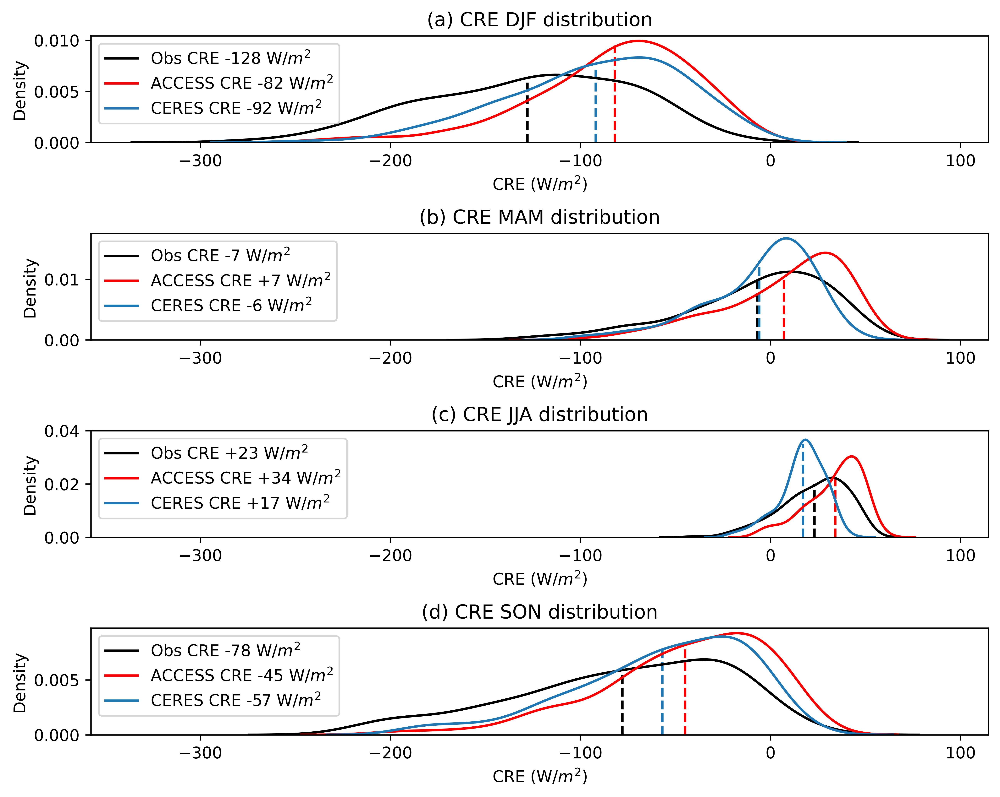

In [51]:
fig = plt.figure(figsize=(10,8),dpi=600)
plt.subplots_adjust(hspace=0.85)

ax1 = plt.subplot(411,)
sns.kdeplot(x=DJF_obs_CRE, label='Obs CRE -128 W/$m^{2}$', color='black')
sns.kdeplot(x=DJF_model_CRE, label='ACCESS CRE -82 W/$m^{2}$', color='red')
sns.kdeplot(x=DJF_sat_CRE, label='CERES CRE -92 W/$m^{2}$');
ax1.vlines([-128], 0, 0.0063, linestyles='dashed', colors='black')
ax1.vlines([-82], 0, 0.0095, linestyles='dashed', colors='red')
ax1.vlines([-92], 0, 0.0075, linestyles='dashed')
plt.legend(loc='upper left')
plt.title('(a) CRE DJF distribution')
plt.xlabel("CRE (W/$m^{2}$)")

ax2 = plt.subplot(412,sharex=ax1)
sns.kdeplot(x=MAM_obs_CRE, label='Obs CRE -7 W/$m^{2}$', color='black')
sns.kdeplot(x=MAM_model_CRE, label='ACCESS CRE +7 W/$m^{2}$', color='red')
sns.kdeplot(x=MAM_sat_CRE, label='CERES CRE -6 W/$m^{2}$');
ax2.vlines([-7], 0, 0.01, linestyles='dashed', colors='black')
ax2.vlines([+7], 0, 0.01, linestyles='dashed', colors='red')
ax2.vlines([-6], 0, 0.013, linestyles='dashed')
plt.legend(loc='upper left')
plt.title('(b) CRE MAM distribution')
plt.xlabel("CRE (W/$m^{2}$)")

ax3 = plt.subplot(413,sharex=ax1)
sns.kdeplot(x=JJA_obs_CRE, label='Obs CRE +23 W/$m^{2}$', color='black')
sns.kdeplot(x=JJA_model_CRE, label='ACCESS CRE +34 W/$m^{2}$', color='red')
sns.kdeplot(x=JJA_sat_CRE, label='CERES CRE +17 W/$m^{2}$');
ax3.vlines([+23], 0, 0.02, linestyles='dashed', colors='black')
ax3.vlines([+34], 0, 0.023, linestyles='dashed', colors='red')
ax3.vlines([+17], 0, 0.035, linestyles='dashed')
plt.legend(loc='upper left')
plt.title('(c) CRE JJA distribution')
plt.xlabel("CRE (W/$m^{2}$)")
plt.ylim(0,0.04)

ax4 = plt.subplot(414,sharex=ax1)
sns.kdeplot(x=SON_obs_CRE, label='Obs CRE -78 W/$m^{2}$', color='black')
sns.kdeplot(x=SON_model_CRE, label='ACCESS CRE -45 W/$m^{2}$', color='red')
sns.kdeplot(x=SON_sat_CRE, label='CERES CRE -57 W/$m^{2}$');
ax4.vlines([-78], 0, 0.006, linestyles='dashed', colors='black')
ax4.vlines([-45], 0, 0.008, linestyles='dashed', colors='red')
ax4.vlines([-57], 0, 0.0078, linestyles='dashed')
plt.legend(loc='upper left')
plt.xlabel("CRE (W/$m^{2}$)")
plt.title('(d) CRE SON distribution')
#plt.savefig('/Users/peizhangcheng/Desktop/CRE_seasonal_distribution.jpg')

In [52]:
fig = plt.figure(figsize=(25,13),dpi=600)
plt.subplots_adjust(hspace=0.85)

ax1 = plt.subplot(421,)
sns.kdeplot(x=DJF_obs_SWCRE, label='Obs SWCRE -175 W/$m^{2}$', color='black')
sns.kdeplot(x=DJF_model_SWCRE, label='ACCESS SWCRE -134 W/$m^{2}$', color='red')
sns.kdeplot(x=DJF_sat_SWCRE, label='CERES SWCRE -141 W/$m^{2}$');
ax1.vlines([-175], 0, 0.0048, linestyles='dashed', colors='black')
ax1.vlines([-134], 0, 0.008, linestyles='dashed', colors='red')
ax1.vlines([-141], 0, 0.0075, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.title('(a) SW CRE DJF distribution')
plt.xlabel("SW CRE (W/$m^{2}$)")

ax2 = plt.subplot(423,sharex=ax1)
sns.kdeplot(x=MAM_obs_SWCRE, label='Obs SWCRE -58 W/$m^{2}$', color='black')
sns.kdeplot(x=MAM_model_SWCRE, label='ACCESS SWCRE -48 W/$m^{2}$', color='red')
sns.kdeplot(x=MAM_sat_SWCRE, label='CERES SWCRE -49 W/$m^{2}$');
ax2.vlines([-58], 0, 0.009, linestyles='dashed', colors='black')
ax2.vlines([-48], 0, 0.011, linestyles='dashed', colors='red')
ax2.vlines([-49], 0, 0.012, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.xlabel("SW CRE (W/$m^{2}$)")
plt.title('(b) SW CRE MAM distribution')

ax3 = plt.subplot(425,sharex=ax1)
sns.kdeplot(x=JJA_obs_SWCRE, label='Obs SWCRE -28 W/$m^{2}$', color='black')
sns.kdeplot(x=JJA_model_SWCRE, label='ACCESS SWCRE -24 W/$m^{2}$', color='red')
sns.kdeplot(x=JJA_sat_SWCRE, label='CERES SWCRE -24 W/$m^{2}$');
ax3.vlines([-28], 0, 0.027, linestyles='dashed', colors='black')
ax3.vlines([-24], 0, 0.03, linestyles='dashed', colors='red')
ax3.vlines([-24], 0, 0.03, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.xlabel("SW CRE (W/$m^{2}$)")
plt.title('(c) SW CRE JJA distribution')

ax4 = plt.subplot(427,sharex=ax1)
sns.kdeplot(x=SON_obs_SWCRE, label='Obs SWCRE -128 W/$m^{2}$', color='black')
sns.kdeplot(x=SON_model_SWCRE, label='ACCESS SWCRE -99 W/$m^{2}$', color='red')
sns.kdeplot(x=SON_sat_SWCRE, label='CERES SWCRE -106 W/$m^{2}$');
ax4.vlines([-128], 0, 0.0055, linestyles='dashed', colors='black')
ax4.vlines([-99], 0, 0.0072, linestyles='dashed', colors='red')
ax4.vlines([-106], 0, 0.007, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.xlabel("SW CRE (W/$m^{2}$)")
plt.ylim(0,0.008)
plt.title('(d) SW CRE SON distribution')

ax5 = plt.subplot(422,)
sns.kdeplot(x=DJF_obs_LWCRE, label='Obs LWCRE +47 W/$m^{2}$', color='black')
sns.kdeplot(x=DJF_model_LWCRE, label='ACCESS LWCRE +52 W/$m^{2}$', color='red')
sns.kdeplot(x=DJF_sat_LWCRE, label='CERES LWCRE +49 W/$m^{2}$');
ax5.vlines([+47], 0, 0.0175, linestyles='dashed', colors='black')
ax5.vlines([+52], 0, 0.034, linestyles='dashed', colors='red')
ax5.vlines([+49], 0, 0.035, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.xlabel("LW CRE (W/$m^{2}$)")
plt.ylim(0,0.04)
plt.title('(e) LW CRE DJF distribution')

ax6 = plt.subplot(424,sharex=ax5)
sns.kdeplot(x=MAM_obs_LWCRE, label='Obs LWCRE +51 W/$m^{2}$', color='black')
sns.kdeplot(x=MAM_model_LWCRE, label='ACCESS LWCRE +55 W/$m^{2}$', color='red')
sns.kdeplot(x=MAM_sat_LWCRE, label='CERES LWCRE +43 W/$m^{2}$');
ax6.vlines([+51], 0, 0.023, linestyles='dashed', colors='black')
ax6.vlines([+55], 0, 0.038, linestyles='dashed', colors='red')
ax6.vlines([+43], 0, 0.04, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.xlabel("LW CRE (W/$m^{2}$)")
plt.title('(f) LW CRE MAM distribution')

ax7 = plt.subplot(426,sharex=ax5)
sns.kdeplot(x=JJA_obs_LWCRE, label='Obs LWCRE +51 W/$m^{2}$', color='black')
sns.kdeplot(x=JJA_model_LWCRE, label='ACCESS LWCRE +58 W/$m^{2}$', color='red')
sns.kdeplot(x=JJA_sat_LWCRE, label='CERES LWCRE +41 W/$m^{2}$');
ax7.vlines([+51], 0, 0.0235, linestyles='dashed', colors='black')
ax7.vlines([+58], 0, 0.034, linestyles='dashed', colors='red')
ax7.vlines([+41], 0, 0.038, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.xlabel("LW CRE (W/$m^{2}$)")
plt.title('(g) LW CRE JJA distribution')

ax8 = plt.subplot(428,sharex=ax5)
sns.kdeplot(x=SON_obs_LWCRE, label='Obs LWCRE +50 W/$m^{2}$', color='black')
sns.kdeplot(x=SON_model_LWCRE, label='ACCESS LWCRE +54 W/$m^{2}$', color='red')
sns.kdeplot(x=SON_sat_LWCRE, label='CERES LWCRE +49 W/$m^{2}$');
ax8.vlines([+50], 0, 0.02, linestyles='dashed', colors='black')
ax8.vlines([+54], 0, 0.032, linestyles='dashed', colors='red')
ax8.vlines([+49], 0, 0.032, linestyles='dashed')
plt.legend(loc='upper left',fontsize=12)
plt.xlabel("LW CRE (W/$m^{2}$)")
plt.ylim(0,0.04)
plt.title('(h) LW CRE SON distribution')

#plt.savefig('/Users/peizhangcheng/Desktop/SW&LW_CRE_seasonal_distribution.jpg')

Text(0.5, 1.0, '(h) LW CRE SON distribution')

Text(0.5, 0, 'LW Cloud Radiative Effect (W/$m^{2}$)')

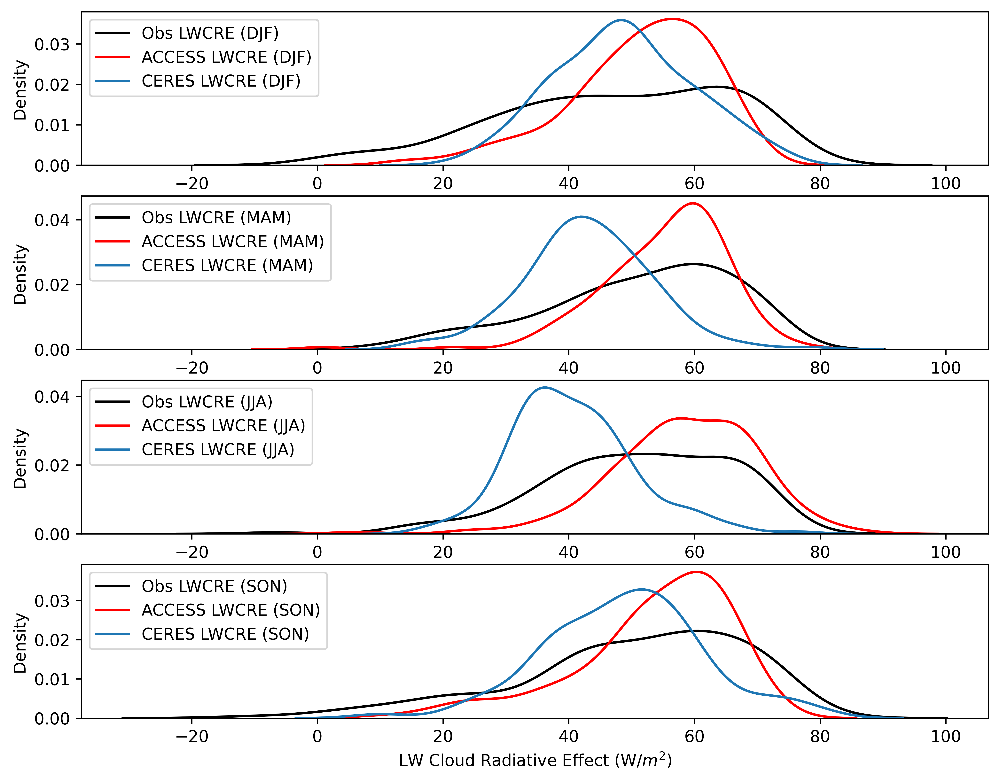

In [53]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax1 = plt.subplot(411,)
sns.kdeplot(x=DJF_obs_LWCRE, label='Obs LWCRE (DJF)', color='black')
sns.kdeplot(x=DJF_model_LWCRE, label='ACCESS LWCRE (DJF)', color='red')
sns.kdeplot(x=DJF_sat_LWCRE, label='CERES LWCRE (DJF)');
plt.legend(loc='upper left')
plt.xlabel("LW Cloud Radiative Effect (DJF) (W/$m^{2}$)")

ax2 = plt.subplot(412,sharex=ax1)
sns.kdeplot(x=MAM_obs_LWCRE, label='Obs LWCRE (MAM)', color='black')
sns.kdeplot(x=MAM_model_LWCRE, label='ACCESS LWCRE (MAM)', color='red')
sns.kdeplot(x=MAM_sat_LWCRE, label='CERES LWCRE (MAM)');
plt.legend(loc='upper left')
plt.xlabel("LW Cloud Radiative Effect (MAM) (W/$m^{2}$)")

ax3 = plt.subplot(413,sharex=ax1)
sns.kdeplot(x=JJA_obs_LWCRE, label='Obs LWCRE (JJA)', color='black')
sns.kdeplot(x=JJA_model_LWCRE, label='ACCESS LWCRE (JJA)', color='red')
sns.kdeplot(x=JJA_sat_LWCRE, label='CERES LWCRE (JJA)');
plt.legend(loc='upper left')
plt.xlabel("LW Cloud Radiative Effect (JJA) (W/$m^{2}$)")

ax4 = plt.subplot(414,sharex=ax1)
sns.kdeplot(x=SON_obs_LWCRE, label='Obs LWCRE (SON)', color='black')
sns.kdeplot(x=SON_model_LWCRE, label='ACCESS LWCRE (SON)', color='red')
sns.kdeplot(x=SON_sat_LWCRE, label='CERES LWCRE (SON)');
plt.legend(loc='upper left')
plt.xlabel("LW Cloud Radiative Effect (W/$m^{2}$)")

## Clear Sky Radiation

Text(0.5, 1.0, '(b) Clear-sky Longwave Radiation (W/$m^{2}$)')

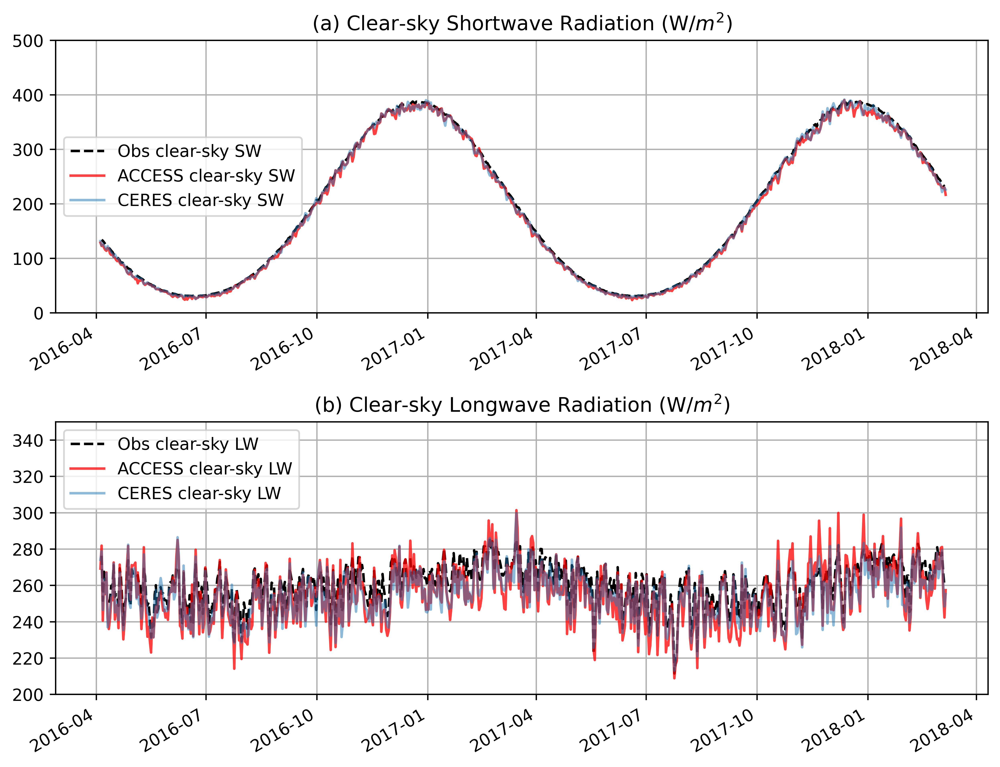

In [8]:
fig = plt.figure(figsize=(10,8),dpi=600)
plt.subplots_adjust(hspace=0.4)

ax1 = plt.subplot(211,)
Obs_SWclr.plot(label='Obs clear-sky SW',color='black',linestyle='--');
ACCESS_SWclr.plot(label='ACCESS clear-sky SW',color='red',alpha=0.75);
Sat_SWclr.plot(label='CERES clear-sky SW',alpha=0.5);
plt.legend();
plt.grid()
plt.ylim(0,500)
plt.title('(a) Clear-sky Shortwave Radiation (W/$m^{2}$)')

ax2 = plt.subplot(212,)
Obs_LWclr.plot(label='Obs clear-sky LW',color='black',linestyle='--');
ACCESS_LWclr.plot(label='ACCESS clear-sky LW',color='red',alpha=0.75);
Sat_LWclr.plot(label='CERES clear-sky LW',alpha=0.5);
plt.legend(loc='upper left');
plt.grid()
plt.ylim(200,350)
plt.title('(b) Clear-sky Longwave Radiation (W/$m^{2}$)')

# plt.savefig('/Users/peizhangcheng/Desktop/SW&LWcs_timeseries.jpg')

In [18]:
ACCESS_SWclr = pd.Series(ACCESS_SWclr, name='ACCESS clear-sky SW')
Obs_SWclr = pd.Series(Obs_SWclr, name='Obs clear-sky SW')
Sat_SWclr = pd.Series(Sat_SWclr, name='CERES clear-sky SW')
pd_SWclr = pd.concat([ACCESS_SWclr,Obs_SWclr,Sat_SWclr],axis=1)
pd_SWclr.corr()

,ACCESS clear-sky SW,Obs clear-sky SW,CERES clear-sky SW
ACCESS clear-sky SW,1.000000,0.999381,0.999621
Obs clear-sky SW,0.999381,1.000000,0.999415
CERES clear-sky SW,0.999621,0.999415,1.000000


In [19]:
ACCESS_LWclr = pd.Series(ACCESS_LWclr, name='ACCESS Clear-sky LW')
Obs_LWclr = pd.Series(Obs_LWclr, name='Obs Clear-sky LW')
Sat_LWclr = pd.Series(Sat_LWclr, name='CERES Clear-sky LW')
pd_LWclr = pd.concat([ACCESS_LWclr,Obs_LWclr,Sat_LWclr],axis=1)
pd_LWclr.corr()

,ACCESS Clear-sky LW,Obs Clear-sky LW,CERES Clear-sky LW
ACCESS Clear-sky LW,1.000000,0.900783,0.937963
Obs Clear-sky LW,0.900783,1.000000,0.925179
CERES Clear-sky LW,0.937963,0.925179,1.000000


Text(0.5, 0, 'Clear-sky Longwave Radiation (W/$m^{2}$)')

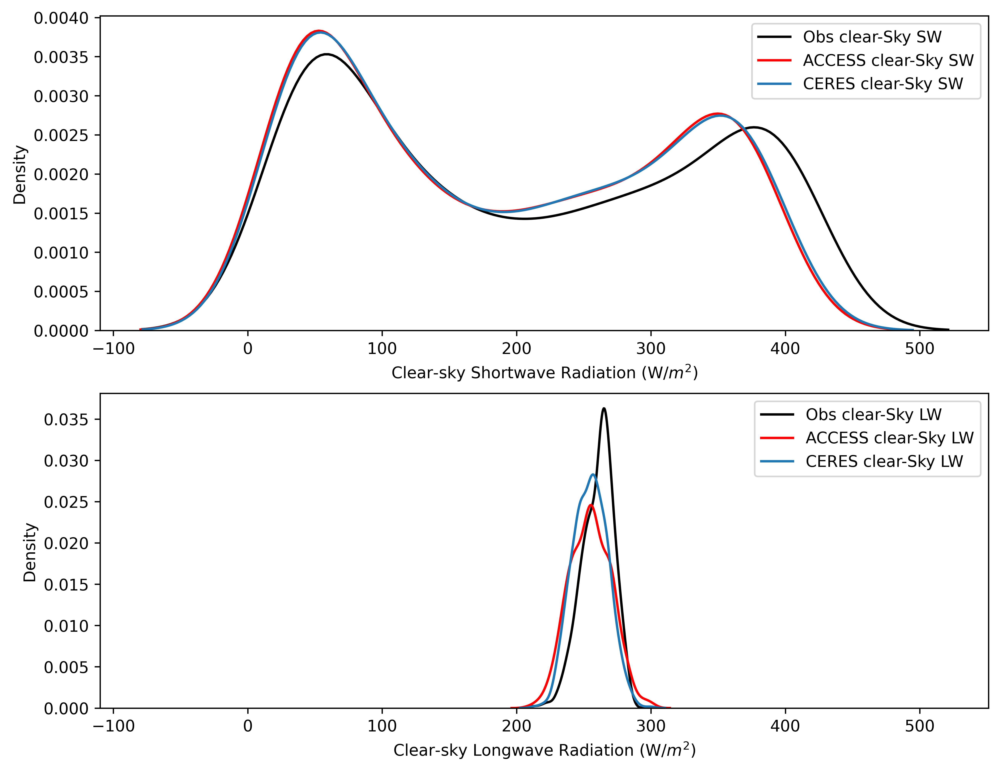

In [20]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax1 = plt.subplot(211,)
sns.kdeplot(x=Obs_SWclr, label='Obs clear-Sky SW', color='black')
sns.kdeplot(x=ACCESS_SWclr, label='ACCESS clear-Sky SW', color='red')
sns.kdeplot(x=Sat_SWclr, label='CERES clear-Sky SW');
plt.legend(loc='upper right')
plt.xlabel("Clear-sky Shortwave Radiation (W/$m^{2}$)")

ax2 = plt.subplot(212,sharex=ax1)
sns.kdeplot(x=Obs_LWclr, label='Obs clear-Sky LW', color='black')
sns.kdeplot(x=ACCESS_LWclr, label='ACCESS clear-Sky LW', color='red')
sns.kdeplot(x=Sat_LWclr, label='CERES clear-Sky LW');
plt.legend(loc='upper right')
plt.xlabel("Clear-sky Longwave Radiation (W/$m^{2}$)")

In [21]:
DJF_obs_SWclr = pd.concat([Obs_SWclr['2016-12':'2017-02'],Obs_SWclr['2017-12':'2018-02']],axis=0)
MAM_obs_SWclr = pd.concat([Obs_SWclr['2016-04':'2016-05'],Obs_SWclr['2017-03':'2017-05'],Obs_SWclr['2018-03']],axis=0)
JJA_obs_SWclr = pd.concat([Obs_SWclr['2016-06':'2016-08'],Obs_SWclr['2017-06':'2017-08']],axis=0)
SON_obs_SWclr = pd.concat([Obs_SWclr['2016-09':'2016-11'],Obs_SWclr['2017-09':'2017-11']],axis=0)

DJF_obs_LWclr = pd.concat([Obs_LWclr['2016-12':'2017-02'],Obs_LWclr['2017-12':'2018-02']],axis=0)
MAM_obs_LWclr = pd.concat([Obs_LWclr['2016-04':'2016-05'],Obs_LWclr['2017-03':'2017-05'],Obs_LWclr['2018-03']],axis=0)
JJA_obs_LWclr = pd.concat([Obs_LWclr['2016-06':'2016-08'],Obs_LWclr['2017-06':'2017-08']],axis=0)
SON_obs_LWclr = pd.concat([Obs_LWclr['2016-09':'2016-11'],Obs_LWclr['2017-09':'2017-11']],axis=0)

DJF_model_SWclr = pd.concat([ACCESS_SWclr['2016-12':'2017-02'],ACCESS_SWclr['2017-12':'2018-02']],axis=0)
MAM_model_SWclr = pd.concat([ACCESS_SWclr['2016-04':'2016-05'],ACCESS_SWclr['2017-03':'2017-05'],ACCESS_SWclr['2018-03']],axis=0)
JJA_model_SWclr = pd.concat([ACCESS_SWclr['2016-06':'2016-08'],ACCESS_SWclr['2017-06':'2017-08']],axis=0)
SON_model_SWclr = pd.concat([ACCESS_SWclr['2016-09':'2016-11'],ACCESS_SWclr['2017-09':'2017-11']],axis=0)

DJF_model_LWclr = pd.concat([ACCESS_LWclr['2016-12':'2017-02'],ACCESS_LWclr['2017-12':'2018-02']],axis=0)
MAM_model_LWclr = pd.concat([ACCESS_LWclr['2016-04':'2016-05'],ACCESS_LWclr['2017-03':'2017-05'],ACCESS_LWclr['2018-03']],axis=0)
JJA_model_LWclr = pd.concat([ACCESS_LWclr['2016-06':'2016-08'],ACCESS_LWclr['2017-06':'2017-08']],axis=0)
SON_model_LWclr = pd.concat([ACCESS_LWclr['2016-09':'2016-11'],ACCESS_LWclr['2017-09':'2017-11']],axis=0)

DJF_sat_SWclr = pd.concat([Sat_SWclr['2016-12':'2017-02'],Sat_SWclr['2017-12':'2018-02']],axis=0)
MAM_sat_SWclr = pd.concat([Sat_SWclr['2016-04':'2016-05'],Sat_SWclr['2017-03':'2017-05'],Sat_SWclr['2018-03']],axis=0)
JJA_sat_SWclr = pd.concat([Sat_SWclr['2016-06':'2016-08'],Sat_SWclr['2017-06':'2017-08']],axis=0)
SON_sat_SWclr = pd.concat([Sat_SWclr['2016-09':'2016-11'],Sat_SWclr['2017-09':'2017-11']],axis=0)

DJF_sat_LWclr = pd.concat([Sat_LWclr['2016-12':'2017-02'],Sat_LWclr['2017-12':'2018-02']],axis=0)
MAM_sat_LWclr = pd.concat([Sat_LWclr['2016-04':'2016-05'],Sat_LWclr['2017-03':'2017-05'],Sat_LWclr['2018-03']],axis=0)
JJA_sat_LWclr = pd.concat([Sat_LWclr['2016-06':'2016-08'],Sat_LWclr['2017-06':'2017-08']],axis=0)
SON_sat_LWclr = pd.concat([Sat_LWclr['2016-09':'2016-11'],Sat_LWclr['2017-09':'2017-11']],axis=0)

Text(0.5, 1.0, '(h) LWcs SON distribtion')

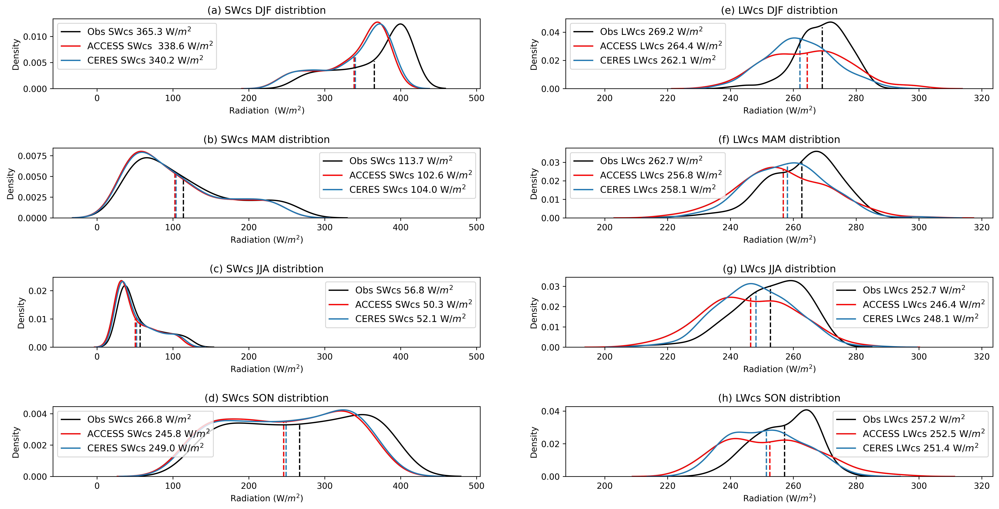

In [59]:
fig = plt.figure(figsize=(20,10),dpi=600)
plt.subplots_adjust(hspace=0.85)

ax1 = plt.subplot(421,)
sns.kdeplot(x=DJF_obs_SWclr, label='Obs SWcs 365.3 W/$m^{2}$',color='black')
sns.kdeplot(x=DJF_model_SWclr, label='ACCESS SWcs  338.6 W/$m^{2}$',color='red');
sns.kdeplot(x=DJF_sat_SWclr, label='CERES SWcs 340.2 W/$m^{2}$');
ax1.vlines([365.3], 0, 0.00527, linestyles='dashed', colors='black')
ax1.vlines([338.6], 0, 0.0064, linestyles='dashed', colors='red')
ax1.vlines([340.2], 0, 0.0062, linestyles='dashed')
plt.legend(loc='upper left',fontsize=11)
plt.xlabel('Radiation  (W/$m^{2}$)')
plt.title('(a) SWcs DJF distribtion')

ax2 = plt.subplot(423,sharex=ax1)
sns.kdeplot(x=MAM_obs_SWclr, label='Obs SWcs 113.7 W/$m^{2}$',color='black')
sns.kdeplot(x=MAM_model_SWclr, label='ACCESS SWcs 102.6 W/$m^{2}$',color='red');
sns.kdeplot(x=MAM_sat_SWclr, label='CERES SWcs 104.0 W/$m^{2}$');
ax2.vlines([113.7], 0, 0.005, linestyles='dashed', colors='black')
ax2.vlines([102.6], 0, 0.0056, linestyles='dashed', colors='red')
ax2.vlines([104.0], 0, 0.0056, linestyles='dashed')
plt.legend(fontsize=11)
plt.xlabel('Radiation (W/$m^{2}$)')
plt.title('(b) SWcs MAM distribtion')

ax3 = plt.subplot(425,sharex=ax1)
sns.kdeplot(x=JJA_obs_SWclr, label='Obs SWcs 56.8 W/$m^{2}$',color='black')
sns.kdeplot(x=JJA_model_SWclr, label='ACCESS SWcs 50.3 W/$m^{2}$',color='red');
sns.kdeplot(x=JJA_sat_SWclr, label='CERES SWcs 52.1 W/$m^{2}$');
ax3.vlines([56.8], 0, 0.01, linestyles='dashed', colors='black')
ax3.vlines([50.3], 0, 0.0105, linestyles='dashed', colors='red')
ax3.vlines([52.1], 0, 0.0105, linestyles='dashed')
plt.legend(fontsize=11)
plt.xlabel('Radiation (W/$m^{2}$)')
plt.title('(c) SWcs JJA distribtion')

ax4 = plt.subplot(427,sharex=ax1)
sns.kdeplot(x=SON_obs_SWclr, label='Obs SWcs 266.8 W/$m^{2}$',color='black')
sns.kdeplot(x=SON_model_SWclr, label='ACCESS SWcs 245.8 W/$m^{2}$',color='red');
sns.kdeplot(x=SON_sat_SWclr, label='CERES SWcs 249.0 W/$m^{2}$');
ax4.vlines([266.8], 0, 0.0034, linestyles='dashed', colors='black')
ax4.vlines([245.8], 0, 0.0035, linestyles='dashed', colors='red')
ax4.vlines([249.0], 0, 0.00355, linestyles='dashed')
plt.legend(loc='upper left',fontsize=11)
plt.xlabel('Radiation (W/$m^{2}$)')
plt.title('(d) SWcs SON distribtion')

ax5 = plt.subplot(422,)
sns.kdeplot(x=DJF_obs_LWclr, label='Obs LWcs 269.2 W/$m^{2}$',color='black')
sns.kdeplot(x=DJF_model_LWclr, label='ACCESS LWcs 264.4 W/$m^{2}$',color='red');
sns.kdeplot(x=DJF_sat_LWclr, label='CERES LWcs 262.1 W/$m^{2}$');
ax5.vlines([269.2], 0, 0.0436, linestyles='dashed', colors='black')
ax5.vlines([264.4], 0, 0.025, linestyles='dashed', colors='red')
ax5.vlines([262.1], 0, 0.036, linestyles='dashed')
plt.legend(fontsize=11)
plt.xlabel('Radiation (W/$m^{2}$)')
plt.title('(e) LWcs DJF distribtion')

ax6 = plt.subplot(424,sharex=ax5)
sns.kdeplot(x=MAM_obs_LWclr, label='Obs LWcs 262.7 W/$m^{2}$',color='black')
sns.kdeplot(x=MAM_model_LWclr, label='ACCESS LWcs 256.8 W/$m^{2}$',color='red');
sns.kdeplot(x=MAM_sat_LWclr, label='CERES LWcs 258.1 W/$m^{2}$');
ax6.vlines([262.7], 0, 0.03, linestyles='dashed', colors='black')
ax6.vlines([256.8], 0, 0.026, linestyles='dashed', colors='red')
ax6.vlines([258.1], 0, 0.029, linestyles='dashed')
plt.legend(fontsize=11)
plt.xlabel('Radiation (W/$m^{2}$)')
plt.title('(f) LWcs MAM distribtion')

ax7 = plt.subplot(426,sharex=ax5)
sns.kdeplot(x=JJA_obs_LWclr, label='Obs LWcs 252.7 W/$m^{2}$',color='black')
sns.kdeplot(x=JJA_model_LWclr, label='ACCESS LWcs 246.4 W/$m^{2}$',color='red');
sns.kdeplot(x=JJA_sat_LWclr, label='CERES LWcs 248.1 W/$m^{2}$');
ax7.vlines([252.7], 0, 0.03, linestyles='dashed', colors='black')
ax7.vlines([246.4], 0, 0.0245, linestyles='dashed', colors='red')
ax7.vlines([248.1], 0, 0.0275, linestyles='dashed')
plt.legend(fontsize=11)
plt.xlabel('Radiation (W/$m^{2}$)')
plt.title('(g) LWcs JJA distribtion')

ax8 = plt.subplot(428,sharex=ax5)
sns.kdeplot(x=SON_obs_LWclr, label='Obs LWcs 257.2 W/$m^{2}$',color='black')
sns.kdeplot(x=SON_model_LWclr, label='ACCESS LWcs 252.5 W/$m^{2}$',color='red');
sns.kdeplot(x=SON_sat_LWclr, label='CERES LWcs 251.4 W/$m^{2}$');
ax8.vlines([257.2], 0, 0.031, linestyles='dashed', colors='black')
ax8.vlines([252.5], 0, 0.0215, linestyles='dashed', colors='red')
ax8.vlines([251.4], 0, 0.0275, linestyles='dashed')
plt.legend(fontsize=11)
plt.xlabel('Radiation (W/$m^{2}$)')
plt.title('(h) LWcs SON distribtion')
#plt.savefig('/Users/peizhangcheng/Desktop/SW&LW_clr_radiation_seasonal.jpg')

In [27]:
Obs_SWclr.dropna()

2016-04-05 12:00:00    141.659403
2016-04-06 12:00:00    139.717895
2016-04-07 12:00:00    136.588858
2016-04-08 12:00:00    133.522221
2016-04-11 12:00:00    126.287716
                          ...    
2018-03-01 12:00:00    257.928858
2018-03-02 12:00:00    254.142463
2018-03-03 12:00:00    250.640379
2018-03-04 12:00:00    247.601623
2018-03-05 12:00:00    245.172570
Name: Obs clear-sky SW, Length: 692, dtype: float64

Text(0.5, 0, 'Clear-sky Longwave Radiation (W/$m^{2}$)')

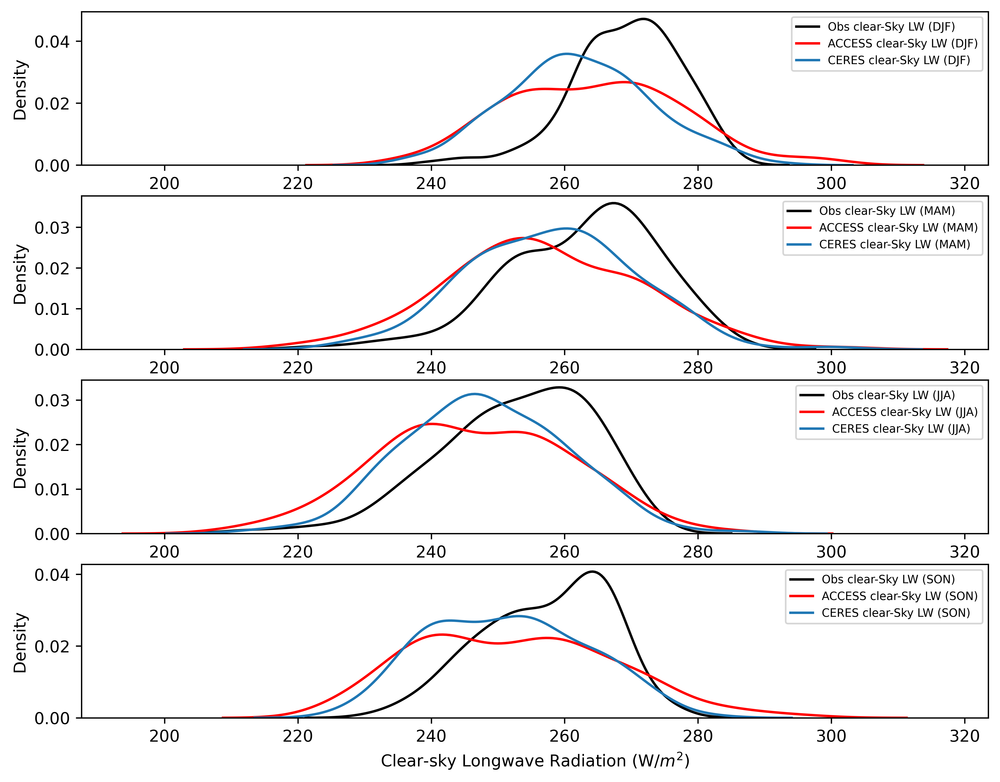

In [60]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax1 = plt.subplot(411,)
sns.kdeplot(x=DJF_obs_LWclr, label='Obs clear-Sky LW (DJF)',color='black')
sns.kdeplot(x=DJF_model_LWclr, label='ACCESS clear-Sky LW (DJF)',color='red');
sns.kdeplot(x=DJF_sat_LWclr, label='CERES clear-Sky LW (DJF)');
plt.legend(fontsize='x-small')
plt.xlabel('Clear-sky Longwave Radiation (DJF) (W/$m^{2}$)')

ax2 = plt.subplot(412,sharex=ax1)
sns.kdeplot(x=MAM_obs_LWclr, label='Obs clear-Sky LW (MAM)',color='black')
sns.kdeplot(x=MAM_model_LWclr, label='ACCESS clear-Sky LW (MAM)',color='red');
sns.kdeplot(x=MAM_sat_LWclr, label='CERES clear-Sky LW (MAM)');
plt.legend(fontsize='x-small')
plt.xlabel('Clear-sky Longwave Radiation (MAM) (W/$m^{2}$)')

ax3 = plt.subplot(413,sharex=ax1)
sns.kdeplot(x=JJA_obs_LWclr, label='Obs clear-Sky LW (JJA)',color='black')
sns.kdeplot(x=JJA_model_LWclr, label='ACCESS clear-Sky LW (JJA)',color='red');
sns.kdeplot(x=JJA_sat_LWclr, label='CERES clear-Sky LW (JJA)');
plt.legend(fontsize='x-small')
plt.xlabel('Clear-sky Longwave Radiation (JJA) (W/$m^{2}$)')

ax4 = plt.subplot(414,sharex=ax1)
sns.kdeplot(x=SON_obs_LWclr, label='Obs clear-Sky LW (SON)',color='black')
sns.kdeplot(x=SON_model_LWclr, label='ACCESS clear-Sky LW (SON)',color='red');
sns.kdeplot(x=SON_sat_LWclr, label='CERES clear-Sky LW (SON)');
plt.legend(fontsize='x-small')
plt.xlabel('Clear-sky Longwave Radiation (W/$m^{2}$)')

In [92]:
stats.ttest_ind(DJF_obs_SWclr.dropna(),DJF_model_SWclr.dropna())

Ttest_indResult(statistic=5.682945231656039, pvalue=2.76865121177654e-08)

In [101]:
stats.ttest_ind(DJF_obs_LWclr.dropna(),DJF_model_LWclr.dropna())

Ttest_indResult(statistic=4.233059871396049, pvalue=2.941177572739198e-05)

In [93]:
stats.ttest_ind(DJF_obs_SWclr.dropna(),DJF_sat_SWclr.dropna())

Ttest_indResult(statistic=5.289772860697641, pvalue=2.1503003072111135e-07)

In [102]:
stats.ttest_ind(DJF_obs_LWclr.dropna(),DJF_sat_LWclr.dropna())

Ttest_indResult(statistic=7.093607313559552, pvalue=7.157845688330435e-12)

In [94]:
stats.ttest_ind(MAM_obs_SWclr.dropna(),MAM_model_SWclr.dropna())

Ttest_indResult(statistic=1.5290925483839686, pvalue=0.12730942226107061)

In [103]:
stats.ttest_ind(MAM_obs_LWclr.dropna(),MAM_model_LWclr.dropna())

Ttest_indResult(statistic=3.872295204687929, pvalue=0.00013272810619627856)

In [95]:
stats.ttest_ind(MAM_obs_SWclr.dropna(),MAM_sat_SWclr.dropna())

Ttest_indResult(statistic=1.3364616554011048, pvalue=0.18242482382833405)

In [104]:
stats.ttest_ind(MAM_obs_LWclr.dropna(),MAM_sat_LWclr.dropna())

Ttest_indResult(statistic=3.2951284244187127, pvalue=0.0011033763565968617)

In [97]:
stats.ttest_ind(JJA_obs_SWclr.dropna(),JJA_model_SWclr.dropna())

Ttest_indResult(statistic=2.371358021688088, pvalue=0.018242671095948813)

In [105]:
stats.ttest_ind(JJA_obs_LWclr.dropna(),JJA_model_LWclr.dropna())

Ttest_indResult(statistic=4.650839115194023, pvalue=4.633045699666e-06)

In [98]:
stats.ttest_ind(JJA_obs_SWclr.dropna(),JJA_sat_SWclr.dropna())

Ttest_indResult(statistic=1.7001514096673236, pvalue=0.08995664961755451)

In [106]:
stats.ttest_ind(JJA_obs_LWclr.dropna(),JJA_sat_LWclr.dropna())

Ttest_indResult(statistic=3.7412276604277324, pvalue=0.00021268175372226127)

In [99]:
stats.ttest_ind(SON_obs_SWclr.dropna(),SON_model_SWclr.dropna())

Ttest_indResult(statistic=2.5204575513394545, pvalue=0.01214944669075397)

In [107]:
stats.ttest_ind(SON_obs_LWclr.dropna(),SON_model_LWclr.dropna())

Ttest_indResult(statistic=3.656911782508451, pvalue=0.00029312223020821847)

In [100]:
stats.ttest_ind(SON_obs_SWclr.dropna(),SON_sat_SWclr.dropna())

Ttest_indResult(statistic=2.1404914161046285, pvalue=0.03298276209826877)

In [108]:
stats.ttest_ind(SON_obs_LWclr.dropna(),SON_sat_LWclr.dropna())

Ttest_indResult(statistic=5.258670730275175, pvalue=2.4873257243270603e-07)

<ipython-input-61-e568941b55c4>:13: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
<ipython-input-61-e568941b55c4>:30: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x2, y2, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


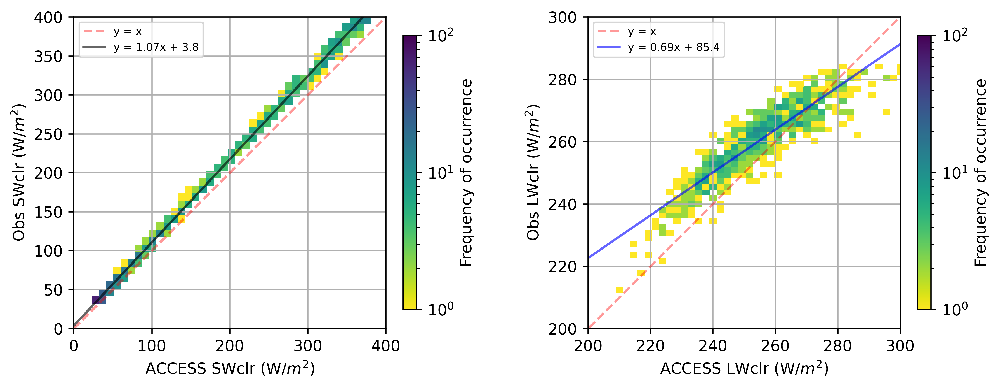

In [61]:
fig = plt.figure(figsize=(10,8), dpi=600)
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)

x1 = np_ACCESS_SWclr
y1 = np_Obs_SWclr
x = np.arange(0,400)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS SWclr (W/$m^{2}$)')
plt.ylabel('Obs SWclr (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(0,400)
plt.ylim(0,400)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,1.068*x + 3.777,"-",color='black',alpha=0.6,label='y = 1.07x + 3.8')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

ax2 = plt.subplot(122,)

x2 = np_ACCESS_LWclr
y2 = np_Obs_LWclr

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS LWclr (W/$m^{2}$)')
plt.ylabel('Obs LWclr (W/$m^{2}$)')
plt.hist2d(x2, y2, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(200,300)
plt.ylim(200,300)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.6862*x + 85.41,"-",color='blue',alpha=0.6,label='y = 0.69x + 85.4')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

In [62]:
z1 = np.polyfit(x1, y1, 1)
p1 = np.poly1d(z1) 
print(p1)

z2 = np.polyfit(x2, y2, 1)
p2 = np.poly1d(z2) 
print(p2)

 
1.068 x + 3.777
 
0.6862 x + 85.4


<ipython-input-63-96be4b65777a>:13: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
<ipython-input-63-96be4b65777a>:30: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x2, y2, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


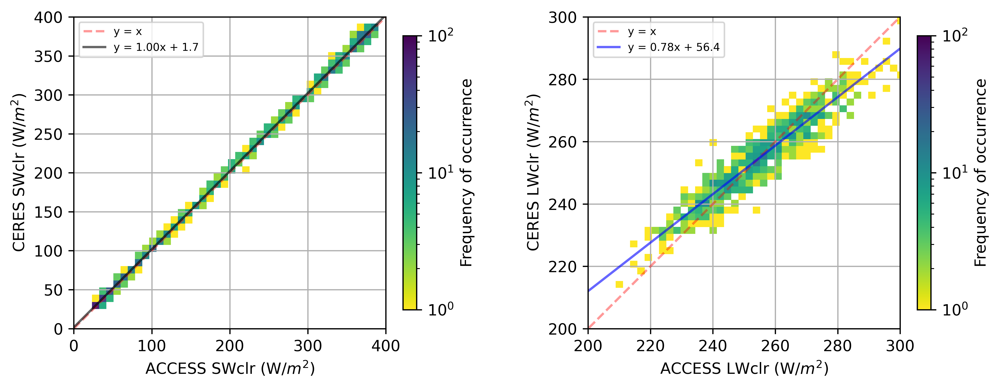

In [63]:
fig = plt.figure(figsize=(10,8), dpi=600)
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)

x1 = np_ACCESS_SWclr
y1 = np_Sat_SWclr
x = np.arange(0,400)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS SWclr (W/$m^{2}$)')
plt.ylabel('CERES SWclr (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(0,400)
plt.ylim(0,400)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,1.002*x+1.718,"-",color='black',alpha=0.6,label='y = 1.00x + 1.7')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

ax2 = plt.subplot(122,)

x2 = np_ACCESS_LWclr
y2 = np_Sat_LWclr

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('ACCESS LWclr (W/$m^{2}$)')
plt.ylabel('CERES LWclr (W/$m^{2}$)')
plt.hist2d(x2, y2, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(200,300)
plt.ylim(200,300)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.7781*x+56.42,"-",color='blue',alpha=0.6,label='y = 0.78x + 56.4')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

<ipython-input-64-9e1203ffdfd8>:13: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
<ipython-input-64-9e1203ffdfd8>:30: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  plt.hist2d(x2, y2, bins=15, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)


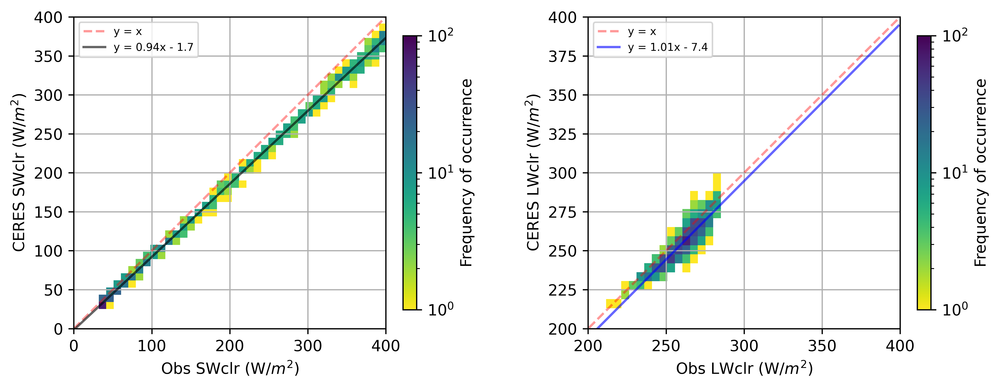

In [64]:
fig = plt.figure(figsize=(10,8), dpi=600)
plt.subplots_adjust(wspace=0.5)

ax1 = plt.subplot(121,)

x1 = np_Obs_SWclr
y1 = np_Sat_SWclr
x = np.arange(0,400)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Obs SWclr (W/$m^{2}$)')
plt.ylabel('CERES SWclr (W/$m^{2}$)')
plt.hist2d(x1, y1, bins=40, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(0,400)
plt.ylim(0,400)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,0.9372*x-1.667,"-",color='black',alpha=0.6,label='y = 0.94x - 1.7')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

ax2 = plt.subplot(122,)

x2 = np_Obs_LWclr
y2 = np_Sat_LWclr

plt.gca().set_aspect('equal', adjustable='box')
plt.xlabel('Obs LWclr (W/$m^{2}$)')
plt.ylabel('CERES LWclr (W/$m^{2}$)')
plt.hist2d(x2, y2, bins=15, norm=LogNorm(), cmap='viridis_r', vmin=1, vmax=100)
plt.xlim(200,400)
plt.ylim(200,400)
plt.plot(x,x,"--",color='r',alpha=0.4,label='y = x')
plt.plot(x,1.007*x-7.391,"-",color='blue',alpha=0.6,label='y = 1.01x - 7.4')
plt.legend(fontsize=7)
plt.grid()
plt.colorbar(label='Frequency of occurrence', fraction=0.04)

In [65]:
print(np.mean(np_ACCESS_SWclr),np.mean(np_Obs_SWclr),np.mean(np_Sat_SWclr))

187.14572853331288 203.62369077263796 189.17007472312795


In [66]:
print(np.std(np_ACCESS_SWclr),np.std(np_Obs_SWclr),np.std(np_Sat_SWclr))

127.55492396612243 136.29567782999695 127.81192647216795


In [67]:
print(np.mean(np_ACCESS_LWclr),np.mean(np_Obs_LWclr),np.mean(np_Sat_LWclr))

254.85869870644865 260.2833010747806 254.71866430048422


In [68]:
print(np.std(np_ACCESS_LWclr),np.std(np_Obs_LWclr),np.std(np_Sat_LWclr))

15.616268356426833 11.8958961230183 12.947745195078161


In [69]:
print(np.mean(SON_model_SWclr),np.mean(SON_obs_SWclr),np.mean(SON_sat_SWclr))

245.82193736894607 266.7897873191045 248.9782729816814


In [70]:
print(np.std(SON_model_SWclr),np.std(SON_obs_SWclr),np.std(SON_sat_SWclr))

76.93897052306457 81.28242740571385 76.98127247645486


In [71]:
print(np.mean(SON_model_LWclr),np.mean(SON_obs_LWclr),np.mean(SON_sat_LWclr))

252.47399660680205 257.2314589542688 251.36929439650322


In [72]:
print(np.std(SON_model_LWclr),np.std(SON_obs_LWclr),np.std(SON_sat_LWclr))

14.7398475098301 9.437929351855248 11.655600675952895


In [73]:
print(np.mean(DJF_model_SWclr),np.mean(DJF_obs_SWclr),np.mean(DJF_sat_SWclr))

338.6311878007284 365.2522667708358 340.2333091163204


In [74]:
print(np.std(DJF_model_SWclr),np.std(DJF_obs_SWclr),np.std(DJF_sat_SWclr))

42.713933689592814 45.38177675080422 43.588641602063966


In [75]:
print(np.mean(DJF_model_LWclr),np.mean(DJF_obs_LWclr),np.mean(DJF_sat_LWclr))

264.36084410175965 269.2291671051735 262.132467431572


In [76]:
print(np.std(DJF_model_LWclr),np.std(DJF_obs_LWclr),np.std(DJF_sat_LWclr))

13.019447629863565 8.037769282263733 10.608893439390085


In [77]:
print(np.mean(MAM_model_SWclr),np.mean(MAM_obs_SWclr),np.mean(MAM_sat_SWclr))

102.59088927173013 113.68406766373742 103.98931719288667


In [78]:
print(np.std(MAM_model_SWclr),np.std(MAM_obs_SWclr),np.std(MAM_sat_SWclr))

60.04594734151505 64.68325083953445 60.03337410635


In [79]:
print(np.mean(MAM_model_LWclr),np.mean(MAM_obs_LWclr),np.mean(MAM_sat_LWclr))

256.8213588813393 262.6603960497176 258.10934185389584


In [80]:
print(np.std(MAM_model_LWclr),np.std(MAM_obs_LWclr),np.std(MAM_sat_LWclr))

14.431720414832865 11.324427348165536 12.412773707099491


In [81]:
print(np.mean(JJA_model_SWclr),np.mean(JJA_obs_SWclr),np.mean(JJA_sat_SWclr))

50.28883942014703 56.81979866384031 52.10769803985426


In [82]:
print(np.std(JJA_model_SWclr),np.std(JJA_obs_SWclr),np.std(JJA_sat_SWclr))

25.1242141858674 27.37255770970342 25.47158107262104


In [83]:
print(np.mean(JJA_model_LWclr),np.mean(JJA_obs_LWclr),np.mean(JJA_sat_LWclr))

246.3898327813757 252.68157408711681 248.07777582907755


In [84]:
print(np.std(JJA_model_LWclr),np.std(JJA_obs_LWclr),np.std(JJA_sat_LWclr))

14.258331190590264 11.392166607937762 12.075442017336037


Text(0, 0.5, 'Density')

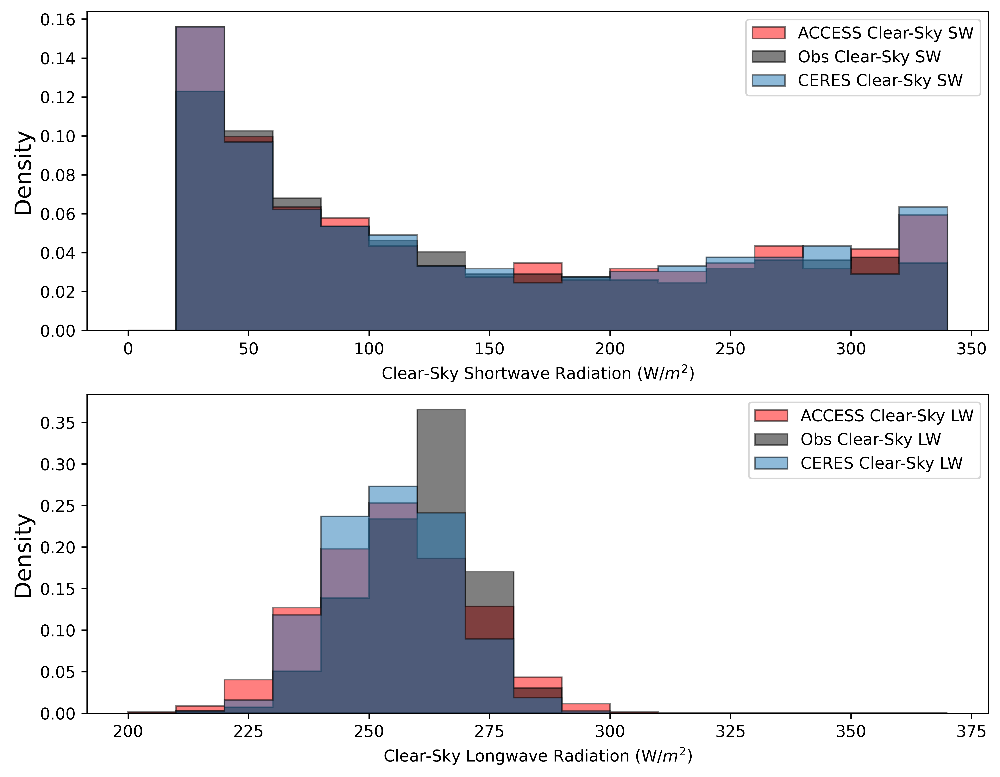

In [85]:
fig = plt.figure(figsize=(10,8),dpi=600)

ax1 = plt.subplot(211,)
weights1 = np.ones_like(np_ACCESS_SWclr) / len(np_ACCESS_SWclr)
weights2 = np.ones_like(np_Obs_SWclr) / len(np_Obs_SWclr)
weights3 = np.ones_like(np_Sat_SWclr) / len(np_Sat_SWclr)

plt.hist(np_ACCESS_SWclr, weights=weights1, bins=np.arange(0,350,20), histtype="stepfilled", alpha=0.5, edgecolor='black', label='ACCESS Clear-Sky SW',color='red')
plt.hist(np_Obs_SWclr, weights=weights2, bins=np.arange(0,350,20), histtype="stepfilled", alpha=0.5, edgecolor='black', label='Obs Clear-Sky SW',color='black')
plt.hist(np_Sat_SWclr, weights=weights3, bins=np.arange(0,350,20), histtype="stepfilled", alpha=0.5, edgecolor='black', label='CERES Clear-Sky SW')
plt.legend()
plt.xlabel('Clear-Sky Shortwave Radiation (W/$m^{2}$)')
ax1.set_ylabel("Density", fontsize=14)

ax2 = plt.subplot(212,)
weights4 = np.ones_like(np_ACCESS_LWclr) / len(np_ACCESS_LWclr)
weights5 = np.ones_like(np_Obs_LWclr) / len(np_Obs_LWclr)
weights6 = np.ones_like(np_Sat_LWclr) / len(np_Sat_LWclr)

plt.hist(np_ACCESS_LWclr, weights=weights4, bins=np.arange(200,375,10), histtype="stepfilled", alpha=0.5, edgecolor='black', label='ACCESS Clear-Sky LW',color='red')
plt.hist(np_Obs_LWclr, weights=weights5, bins=np.arange(200,375,10), histtype="stepfilled", alpha=0.5, edgecolor='black', label='Obs Clear-Sky LW',color='black')
plt.hist(np_Sat_LWclr, weights=weights6, bins=np.arange(200,375,10), histtype="stepfilled", alpha=0.5, edgecolor='black', label='CERES Clear-Sky LW')
plt.legend()
plt.xlabel('Clear-Sky Longwave Radiation (W/$m^{2}$)')
ax2.set_ylabel("Density", fontsize=14)